<a href="https://colab.research.google.com/github/CCosta-Code/TextMiningHomework/blob/master/001_EDA_20231007.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Run the following chunk to stablish GDrive connection

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Install PYOD because is not available into the sistem

In [ ]:
!pip install pyod

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.4/153.4 kB 3.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyod: filename=pyod-1.1.0-py3-none-any.whl size=185329 sha256=e55529bdabb7135bce9512f39a78245a0f0b6a853be32c4610cdc6ef3ee79c5b
  Stored in directory: /root/.cache/pip/wheels/36/8e/e2/e932956b10b843eb6be9eefa70b5c1bee7b561be14c423b136
Successfully built pyod


In [ ]:
import io
import os
import json
import pickle
import joblib
import datetime
import numpy as np
import pandas as pd
import datetime as dt
import time

from tqdm import tqdm
from google.cloud import storage
from google.cloud import bigquery

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns

from datetime import datetime, timedelta
import matplotlib.cm as cm
from scipy import stats

from pyod.models.copod import COPOD

import warnings
warnings.filterwarnings("ignore")

start=dt.datetime.now()

end=dt.datetime.now()
print(end - start)

In [ ]:
 # Final Data
query_file = './query_ts.sql'
gads_history = 'bi-fcom-drmb-init-two-sbx.acc_fcom_cl_google_ads.campaign_googleads_clickstream_nmv_daily_v2'
cybers = ', '.join(["'2022-05-30'","'2022-05-31'","'2022-06-01'", "'2022-10-03'","'2022-10-04'","'2022-10-05'", "'2023-05-29'","'2023-05-30'","'2023-05-31'"])
min_date = '2022-01-17'
max_date = '2023-08-22'    #date.today().strftime("%Y-%m-%d")
# Tomemos esta como fecha máxima ya que luego de eso se cambiaron los nombres de las campañas a F y la data
# no se siguió cargando

### Load raw data

In [ ]:
%%time
# Query raw data
with open(query_file, "r") as file:
    query = file.read()
    file.close()
query = query.replace('cybers', cybers).replace('gads_history', gads_history).replace('min_date', min_date).replace('max_date', max_date)

client = bigquery.Client()
df_raw = pd.read_gbq(query,
                     project_id='tc-sc-bi-bigdata-fcom-adva-dev',
                     use_bqstorage_api=True,
                     progress_bar_type='tqdm').dropna()
df_raw.rename(columns={'orders_net':'orders'}, inplace=True)

Downloading: 100%|██████████| 7967/7967 [00:01<00:00, 6882.81rows/s]

CPU times: user 94.9 ms, sys: 29.8 ms, total: 125 ms
Wall time: 6.18 s


In [ ]:
#### NO FUNCIONAAAAAAAAAAAA ####
!git clone "https://github.com/CCosta-Code/UNR_2023.git"

Cloning into 'UNR_2023'...
fatal: could not read Username for 'https://github.com': No such device or address


In [ ]:
# Exportar a formato Parquet
#df_raw.to_parquet('data_NMV_GAds.parquet', index=False)

# Leer el archivo Parquet en un DataFrame
df_parquet = pd.read_parquet('data_NMV_GAds.parquet')
#print(f'Rows: {df_parquet.shape[0]}\nColumns: {df_parquet.shape[1]}')

In [ ]:
df_raw = df_parquet[(df_parquet['date']>='2022-01-17')]
print(f'Rows: {df_raw.shape[0]}\nColumns: {df_raw.shape[1]}')

Rows: 7964
Columns: 19


In [ ]:
df_raw.head()

,date,week_day,month_day,year_day,month_year,is_event,is_cyber,previous_cyber_days,campaign,budget,cost,clicks,impressions,nmv,visitors,visitors_pur,visits,orders,total_units_net
0,2022-01-17,1,17,17,1,0,0,0,Automotriz,199910.0,20917,354,39672,73731,42,3,44,3,6
1,2022-01-18,2,18,18,1,0,0,0,Automotriz,199910.0,82689,1254,109474,485092,763,11,840,10,14
2,2022-01-19,3,19,19,1,0,0,0,Automotriz,199910.0,88869,4344,124152,877092,1032,14,1216,14,32
3,2022-01-20,4,20,20,1,0,0,0,Automotriz,199910.0,586917,7231,413879,1844538,3120,38,3539,38,53
4,2022-01-21,5,21,21,1,0,0,0,Automotriz,199910.0,1656293,34950,1170805,2064439,8004,41,8728,40,77


#### 15 variables:
- 1 fecha
- 13 num (solo budget es float)
- 1 char

In [ ]:
df_raw.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7964 entries, 0 to 7963
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   date                 7964 non-null   datetime64[ns]
 1   week_day             7964 non-null   int64         
 2   month_day            7964 non-null   int64         
 3   year_day             7964 non-null   int64         
 4   month_year           7964 non-null   int64         
 5   is_event             7964 non-null   int64         
 6   is_cyber             7964 non-null   int64         
 7   previous_cyber_days  7964 non-null   int64         
 8   campaign             7964 non-null   object        
 9   budget               7964 non-null   float64       
 10  cost                 7964 non-null   int64         
 11  clicks               7964 non-null   int64         
 12  impressions          7964 non-null   int64         
 13  nmv                  7964 non-nul

### Missing data review

  0%|          | 0/218 [00:00<?, ?it/s]


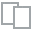
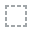
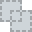
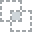
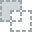
...
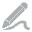
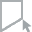
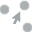
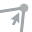
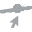

In [ ]:
from dataprep.eda import plot_missing

plot_missing(df_raw)

### Duplicate records

In [ ]:
# Revisar duplicados en df_raw
dups = df_raw[df_raw.duplicated(keep=False)]

print(dups)

           date  week_day  month_day  year_day  month_year  is_event  \
552  2023-07-24         1         24       205           7         0   
553  2023-07-24         1         24       205           7         0   
554  2023-07-25         2         25       206           7         0   
555  2023-07-25         2         25       206           7         0   
1137 2023-07-24         1         24       205           7         0   
1138 2023-07-24         1         24       205           7         0   
1139 2023-07-25         2         25       206           7         0   
1140 2023-07-25         2         25       206           7         0   
1721 2023-07-24         1         24       205           7         0   
1722 2023-07-24         1         24       205           7         0   
1723 2023-07-25         2         25       206           7         0   
1724 2023-07-25         2         25       206           7         0   
2306 2023-07-24         1         24       205           7      

**NOTE:** Los días 2023-07-24 y 2023-07-25 están duplicados para todas las campañas, se conversa con el Data Engineer del equipo que corrobora que hubo un error en el scheduler que itera sobre la tabla así que eliminar los registros

In [ ]:
df_raw = df_raw.drop_duplicates(keep='first')

#df_raw.info()

# Check dups removed
print(df_raw[df_raw.duplicated(keep=False)])

Empty DataFrame
Columns: [date, week_day, month_day, year_day, month_year, is_event, is_cyber, previous_cyber_days, campaign, budget, cost, clicks, impressions, nmv, visitors, visitors_pur, visits, orders, total_units_net]
Index: []


In [ ]:
# Transform budget, cost and nmv to USD
df_raw['budget_USD'] = df_raw['budget'] / 845.33
df_raw['cost_USD'] = df_raw['cost'] / 845.33
df_raw['nmv_USD'] = df_raw['nmv'] / 845.33

In [ ]:
# Create WEEKEND - NO WEEKEND field
df_raw['is_week_day'] = df_raw['date'].apply(lambda x: int(x.dayofweek < 5))

# df_raw.head(15)

In [ ]:
#df_raw.groupby('is_week_day').agg('count')

In [ ]:
# Statistics for num variables
df_raw.drop(['is_event', 'is_cyber', 'week_day','month_day','year_day','month_year',\
             'previous_cyber_days'], axis=1).describe()

,budget,cost,clicks,impressions,nmv,visitors,visitors_pur,visits,orders,total_units_net,budget_USD,cost_USD,nmv_USD,is_week_day
count,7.936000e+03,7.936000e+03,7936.000000,7.936000e+03,7.936000e+03,7936.000000,7936.000000,7936.000000,7936.000000,7936.000000,7936.000000,7936.000000,7936.000000,7936.000000
mean,9.359391e+05,9.531385e+05,15184.668347,1.124367e+06,2.218257e+07,12291.007560,322.786542,16353.947329,317.929940,607.821321,1107.187846,1127.534208,26241.319395,0.715348
std,3.869722e+06,1.992754e+06,15940.490468,1.296176e+06,3.822566e+07,12445.043613,549.299466,17276.258059,543.613172,1101.443162,4577.764857,2357.368665,45219.812305,0.451277
min,2.650000e+02,7.200000e+01,3.000000,1.820000e+02,3.737800e+04,42.000000,1.000000,44.000000,1.000000,1.000000,0.313487,0.085174,44.217051,0.000000
25%,2.606540e+05,2.410540e+05,4160.750000,3.184550e+05,6.431440e+06,3903.000000,79.000000,5043.750000,78.000000,141.000000,308.345853,285.159642,7608.200348,0.000000
50%,5.449740e+05,5.497540e+05,9217.500000,6.438015e+05,1.315915e+07,7483.500000,164.000000,9700.000000,160.000000,306.000000,644.687873,650.342470,15566.884530,1.000000
75%,1.177148e+06,1.126303e+06,21849.500000,1.500764e+06,2.703124e+07,17595.750000,404.000000,23143.500000,398.000000,739.000000,1392.530728,1332.382620,31977.150344,1.000000
max,3.182754e+08,5.892825e+07,203857.000000,2.251760e+07,8.295371e+08,146420.000000,14848.000000,238770.000000,14772.000000,32941.000000,376510.269362,69710.345072,981317.466552,1.000000


In [ ]:
df_raw = df_raw.drop(['budget','cost','nmv'], axis=1) # Remove CLP fields from dataset
df_raw.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7936 entries, 0 to 7963
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   date                 7936 non-null   datetime64[ns]
 1   week_day             7936 non-null   int64         
 2   month_day            7936 non-null   int64         
 3   year_day             7936 non-null   int64         
 4   month_year           7936 non-null   int64         
 5   is_event             7936 non-null   int64         
 6   is_cyber             7936 non-null   int64         
 7   previous_cyber_days  7936 non-null   int64         
 8   campaign             7936 non-null   object        
 9   clicks               7936 non-null   int64         
 10  impressions          7936 non-null   int64         
 11  visitors             7936 non-null   int64         
 12  visitors_pur         7936 non-null   int64         
 13  visits               7936 non-nul

### Correlations

### Quick EDA with Panda's profiling

In [ ]:
%%time
from pandas_profiling import ProfileReport

profile = ProfileReport(df_raw, minimal=True)
profile.to_file(output_file='QuickEDA_raw_data.html')

In [ ]:
from dataprep.eda import plot

plot(df_raw)

### Variable Distributions

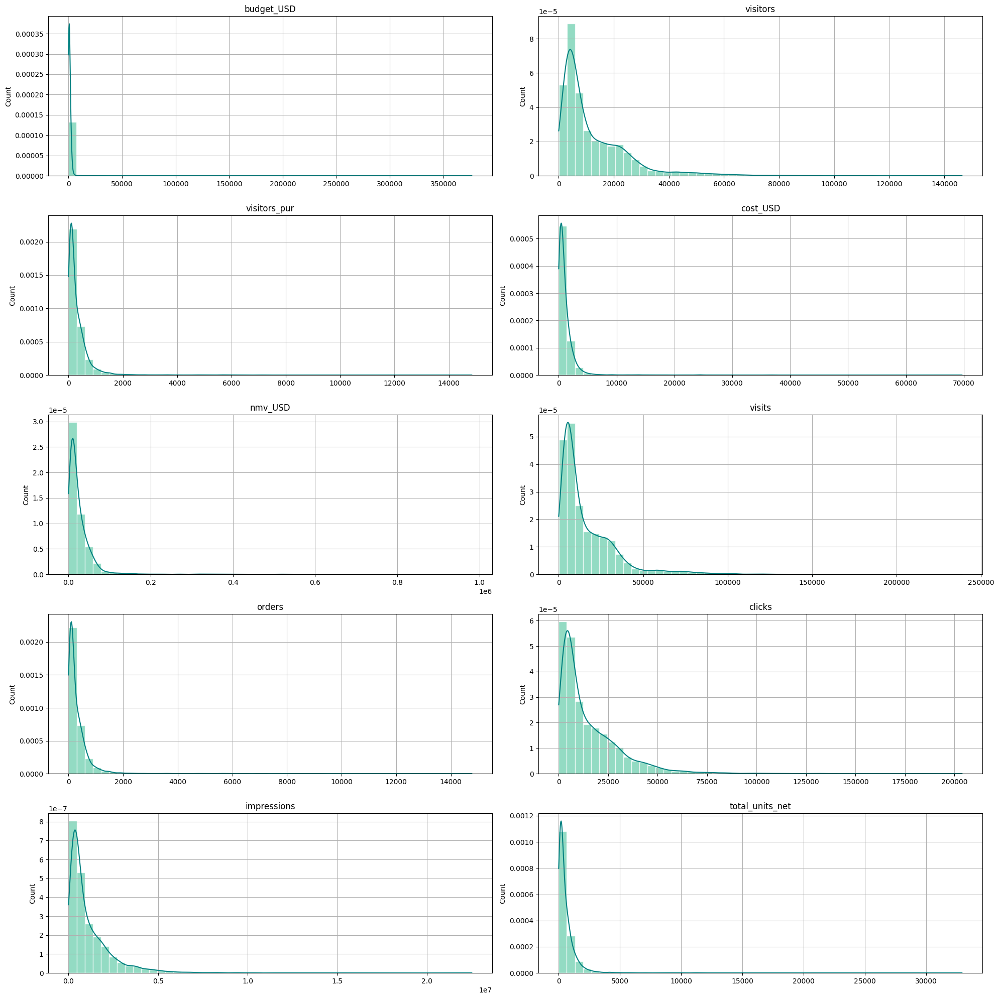

In [ ]:
# Variables to plot
variables = ['budget_USD','cost_USD','nmv_USD','clicks','impressions','visitors','visitors_pur','visits','orders','total_units_net']

cols = 2
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,20))
sns.set_style('whitegrid')

#plt.figure(figsize=(20, 5))

for i, var in enumerate(variables):
    j = i%(rows)
    k = i%(cols)

    axs[j,k].set_title(var)
    # Plot histogram
    _ = axs[j,k].hist(df_raw[var], bins=50, color='mediumaquamarine', alpha=0.7, density=True, label=f'Histogram of {var}')

    # Plot KDE (Kernel Density Estimation) line
    kde = stats.gaussian_kde(df_raw[var].values)
    xx = np.linspace(0, max(df_raw[var]), 1000)
    _ = axs[j,k].plot(xx, kde(xx), label=f'KDE of {var}', color='teal')

    #axs[j,k].set_xlabel(var)
    axs[j,k].set_ylabel('Count')
    axs[j,k].grid(True)
plt.tight_layout()

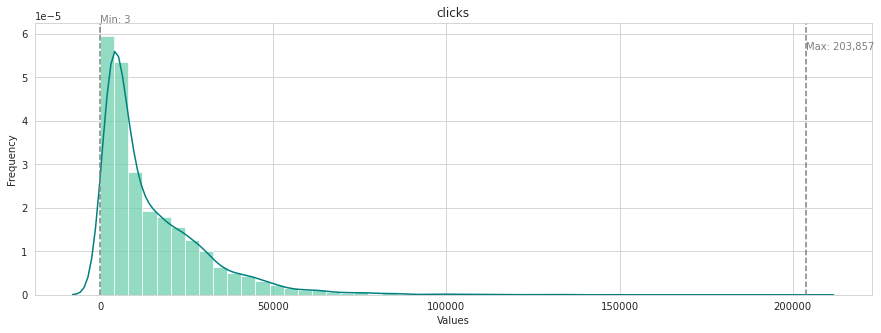

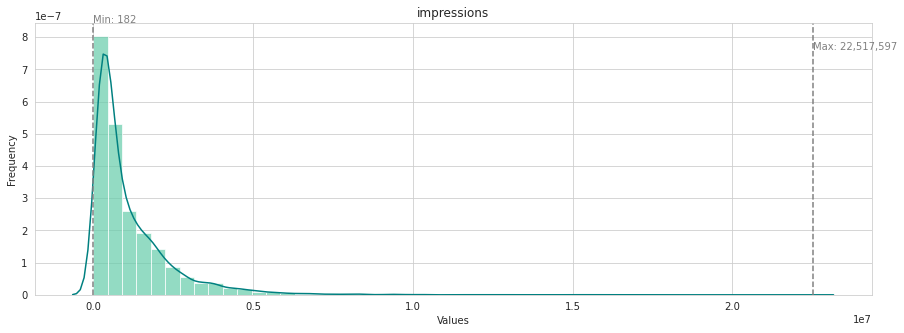

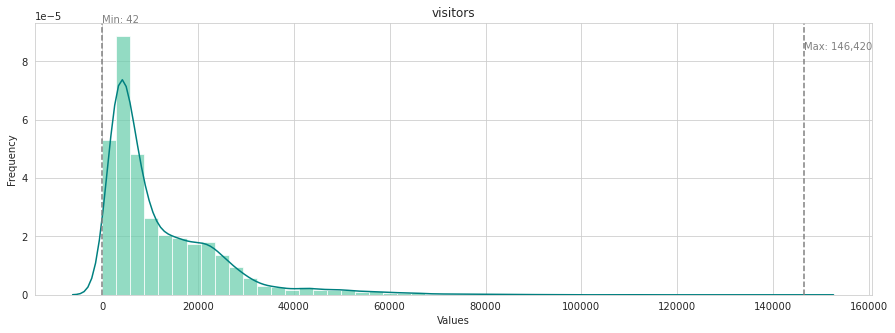

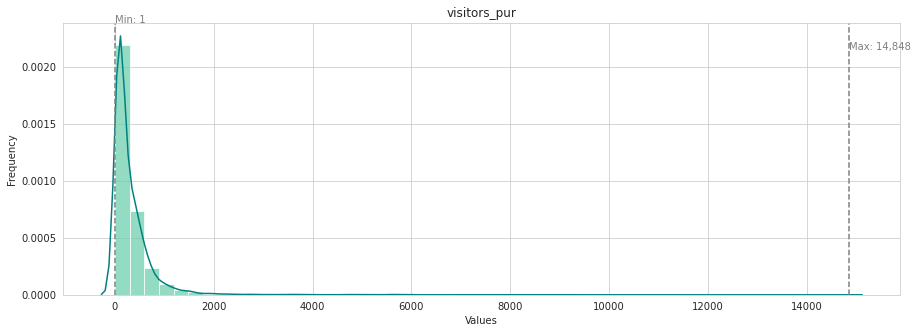

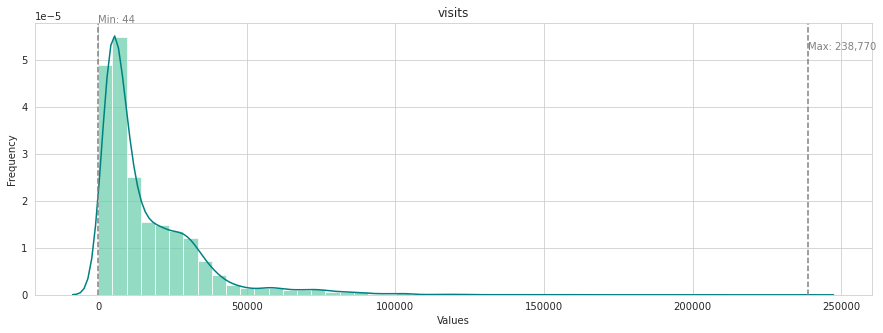

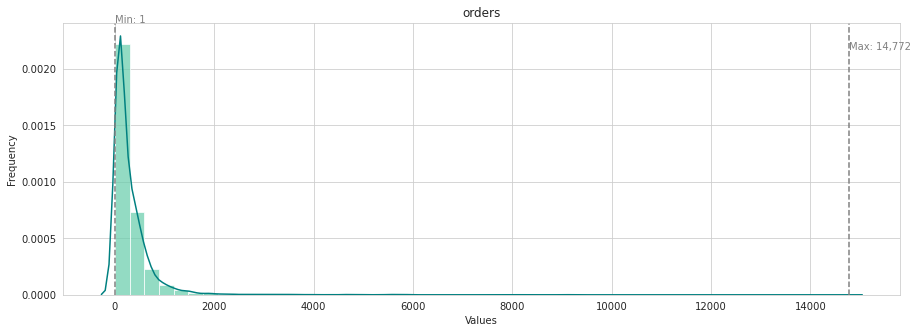

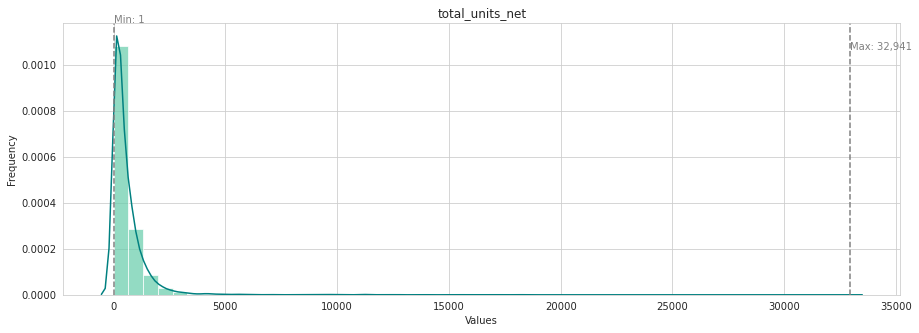

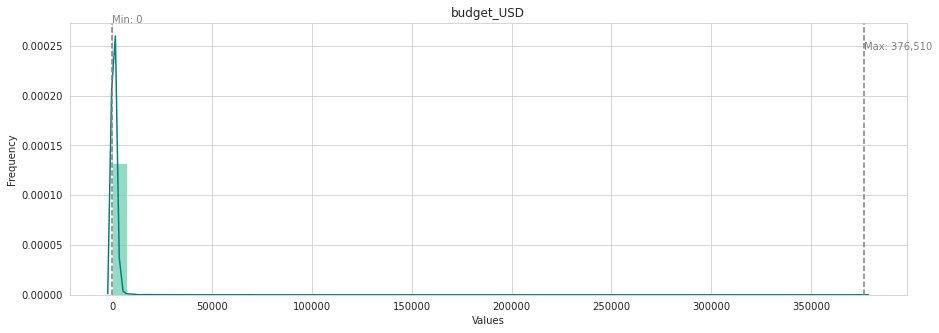

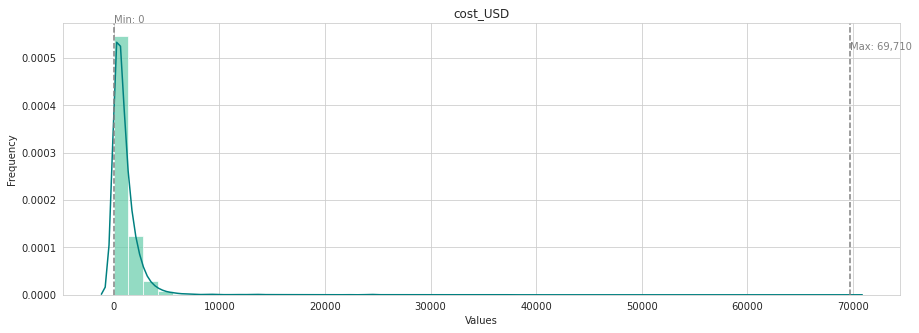

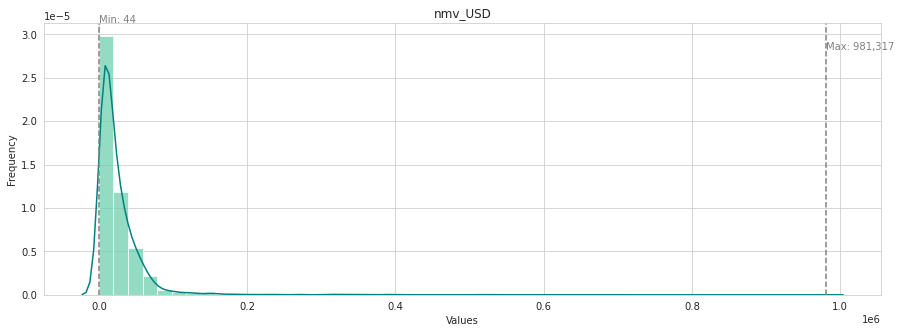

In [ ]:
# Variables to plot
variables = ['clicks','impressions','visitors','visitors_pur','visits','orders','total_units_net','budget_USD','cost_USD','nmv_USD']

# Set the style of seaborn for a white grid
sns.set_style('whitegrid')

# Calculate minimum and maximum for each variable
min_max_values = df_raw[variables].agg(['min', 'max'])

for var in variables:
    plt.figure(figsize=(15, 5))
    # Plot histogram
    plt.hist(df_raw[var], bins=50, alpha=0.7, color='mediumaquamarine', density=True, label=f'Histogram of {var}')

    # Plot KDE (Kernel Density Estimation) line
    sns.kdeplot(df_raw[var], color='teal', label=f'KDE of {var}')

    # Annotate min and max values above the points
    plt.axvline(min_max_values.loc['min', var], color='gray', linestyle='--')
    plt.text(min_max_values.loc['min', var], plt.ylim()[1]*1, f'Min: {min_max_values.loc["min", var]:,.0f}', color='gray')

    plt.axvline(min_max_values.loc['max', var], color='gray', linestyle='--')
    plt.text(min_max_values.loc['max', var], plt.ylim()[1]*0.90, f'Max: {min_max_values.loc["max", var]:,.0f}', color='gray')

    plt.xlabel('Values')
    plt.ylabel('Frequency')
    plt.title(var)

    # Show the plot
    plt.show()

#### Variable distribution using box-plots

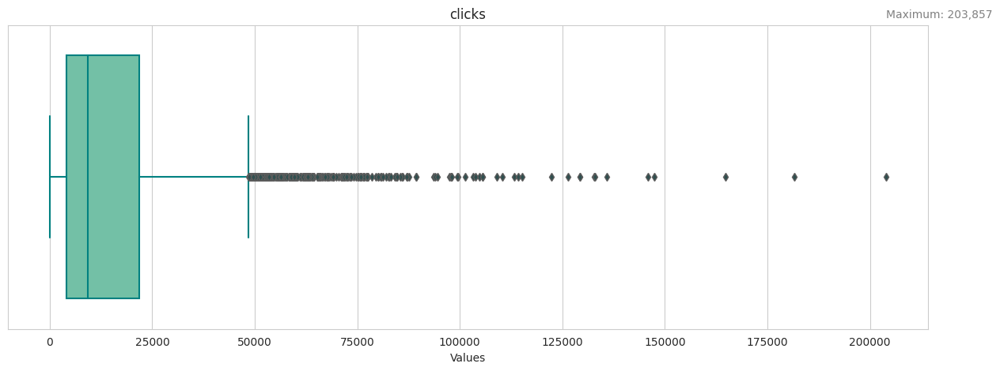

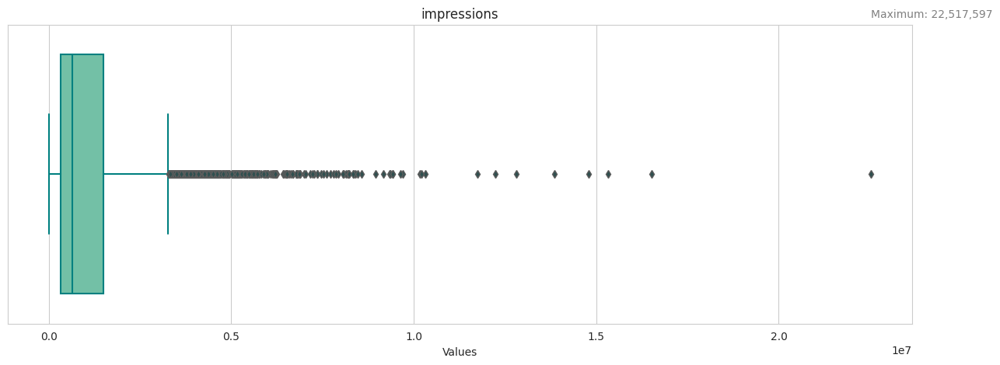

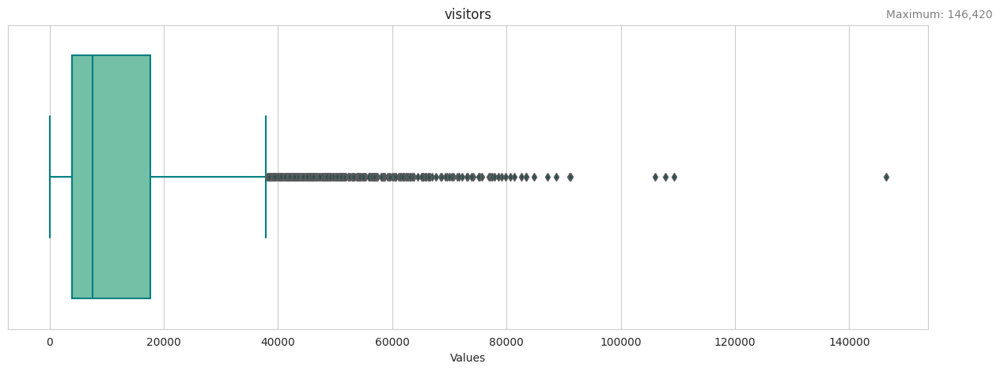

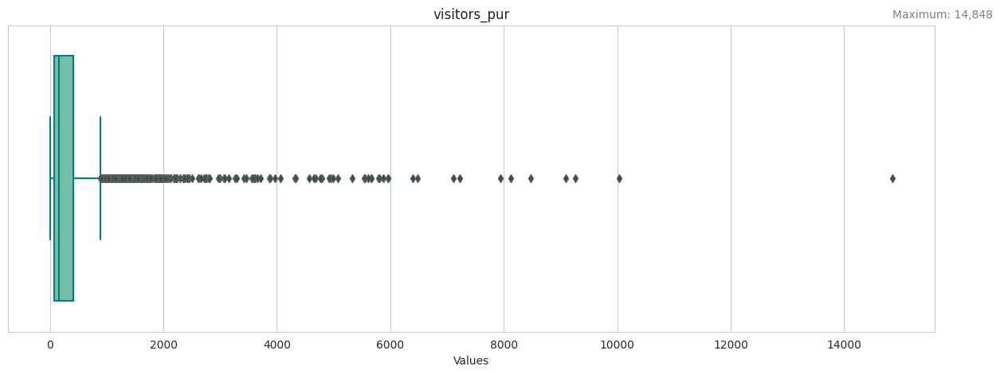

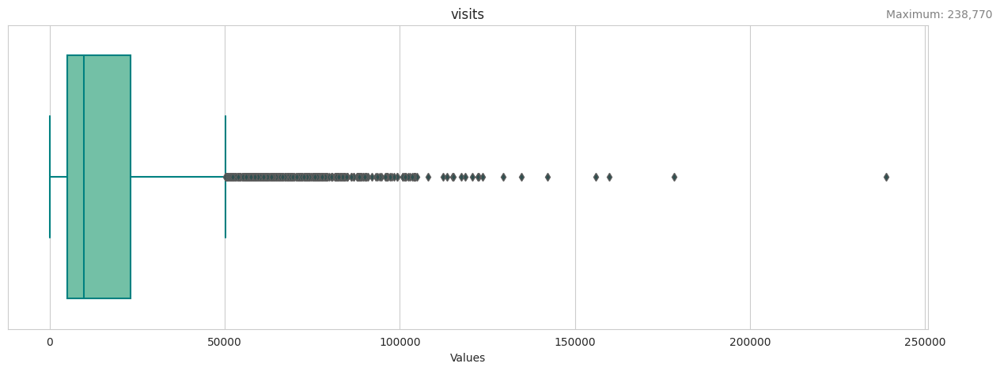

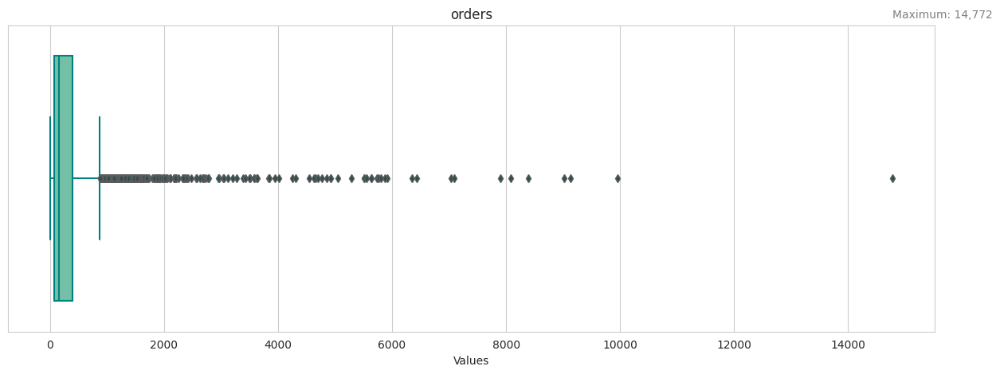

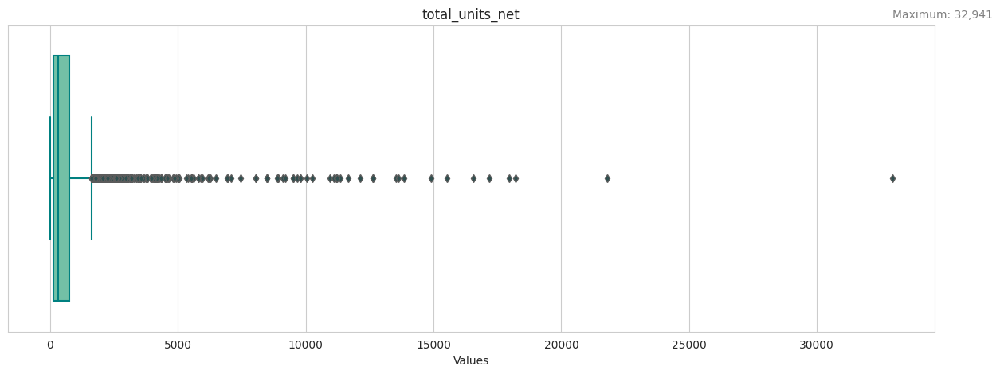

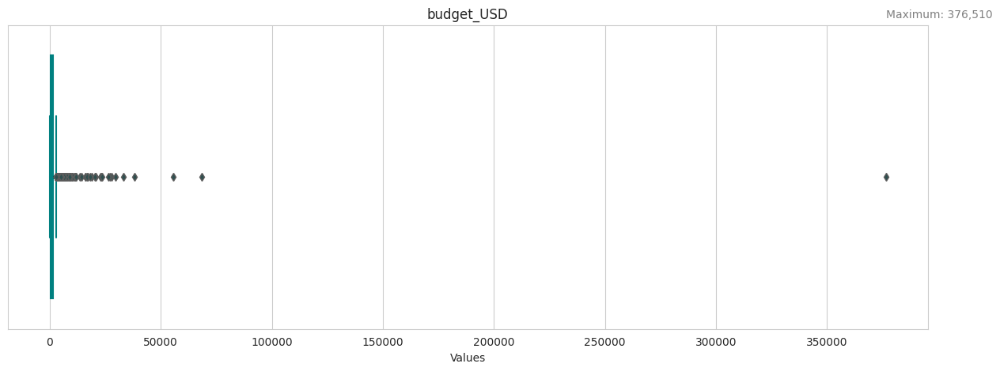

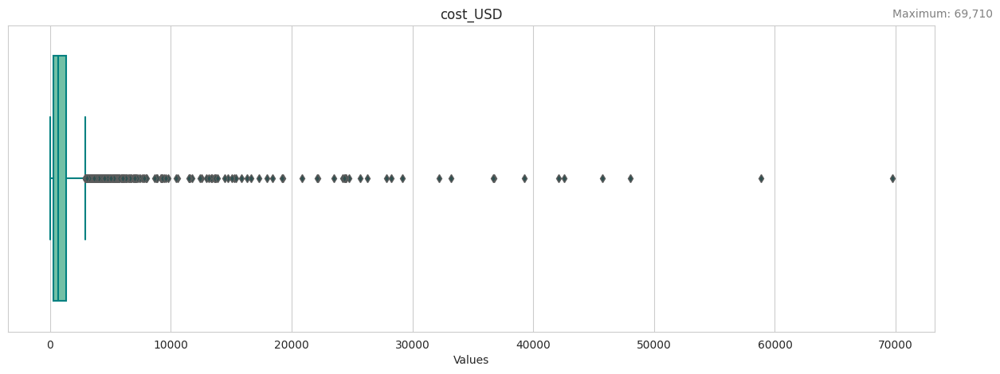

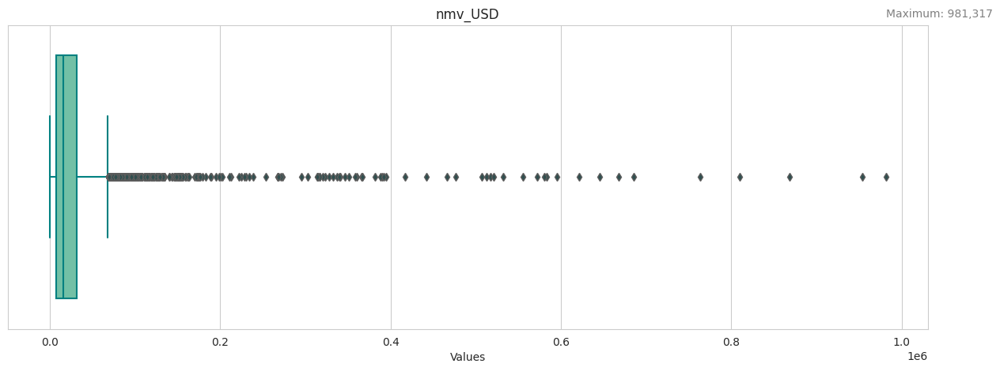

In [ ]:
# Variables to plot
variables = ['clicks','impressions','visitors','visitors_pur','visits','orders','total_units_net','budget_USD','cost_USD','nmv_USD']

# Set the style of seaborn for a white grid
sns.set_style('whitegrid')

# Calculate minimum and maximum for each variable
min_max_values = df_raw[variables].agg(['min', 'max'])

for var in variables:
    plt.figure(figsize=(15, 5))

    # Plot boxplot
    sns.boxplot(x=df_raw[var], color='mediumaquamarine', boxprops=dict(edgecolor='teal'),
                whiskerprops=dict(color='teal'), capprops=dict(color='teal'),
                medianprops=dict(color='teal'), flierprops=dict(markerfacecolor='darkslategray'))

    # Keep this only to remember, in some cases, how to read the x-axis
    plt.text(min_max_values.loc['max', var], plt.ylim()[1]*1.05, f'Maximum: {min_max_values.loc["max", var]:,.0f}', color='gray')

    plt.xlabel('Values')
    plt.title(var)
    plt.show()

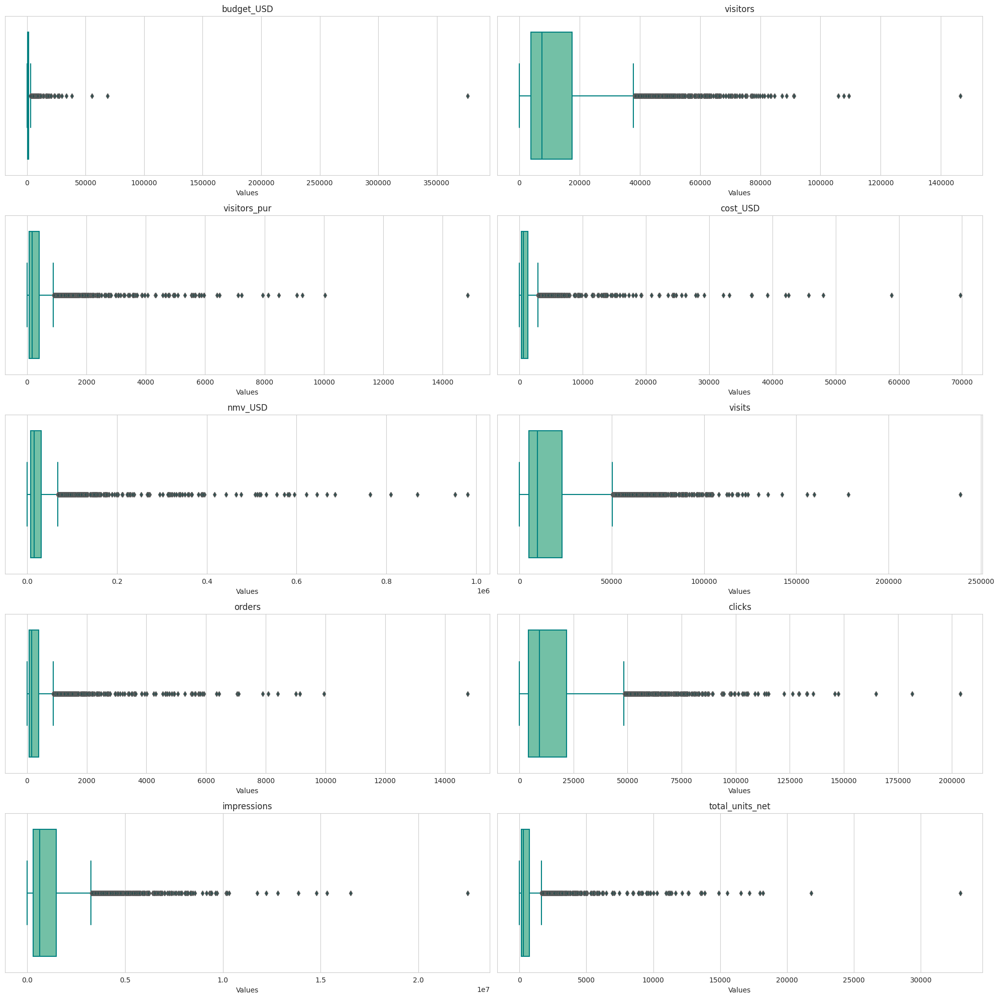

In [ ]:
# Variables to plot
variables = ['budget_USD','cost_USD','nmv_USD','clicks','impressions','visitors','visitors_pur','visits','orders','total_units_net']

# Set the style of seaborn for a white grid
sns.set_style('whitegrid')

# Create a grid of subplots
fig, axs = plt.subplots(5, 2, figsize=(20, 20))

# Iterate through each variable and plot the box plot in the corresponding subplot
for i, var in enumerate(variables):
    j = i%(5)
    k = i%(2)
    sns.boxplot(x=df_raw[var], ax=axs[j,k], color='mediumaquamarine',
                boxprops=dict(edgecolor='teal'),
                whiskerprops=dict(color='teal'),
                capprops=dict(color='teal'),
                medianprops=dict(color='teal'),
                flierprops=dict(markerfacecolor='darkslategray'))

    # Set labels and title for the subplot
    axs[j,k].set_xlabel('Values')
    axs[j,k].set_title(var)

# Adjust layout to prevent overlapping
plt.tight_layout()

# Show the plot
plt.show()


**NOTE:** Las distribuciones de los campos son muy asimétricos entonces aplicaremos el log() porque estoy podría mejorar a representar la data y ayudar a resaltar patrones y tendencias que pueden no ser tan evidentes.

#### Variable distribution by campaign

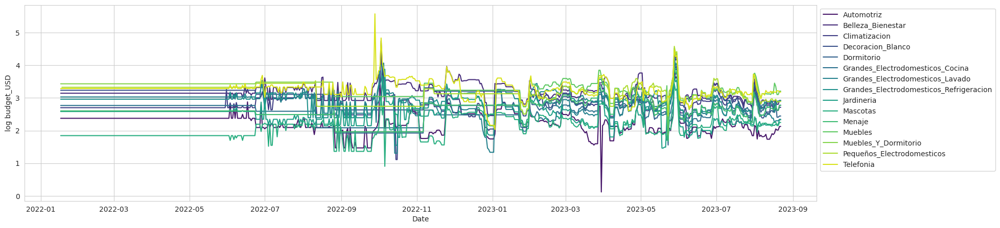

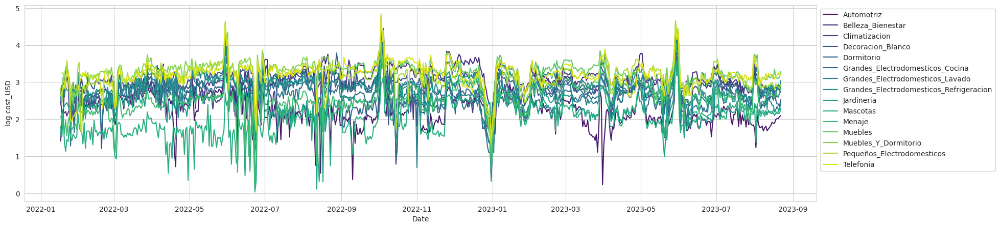

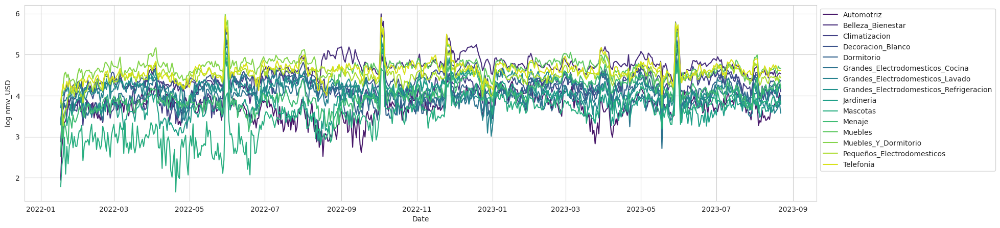

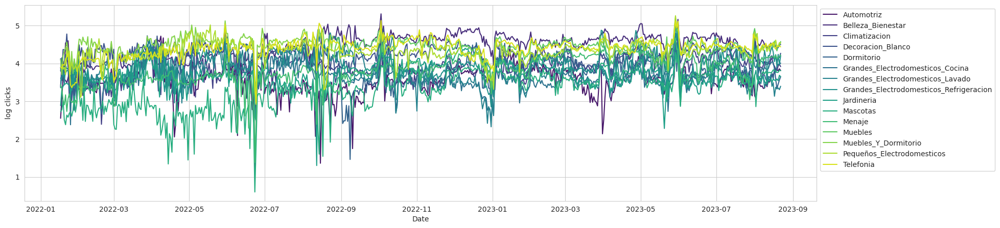

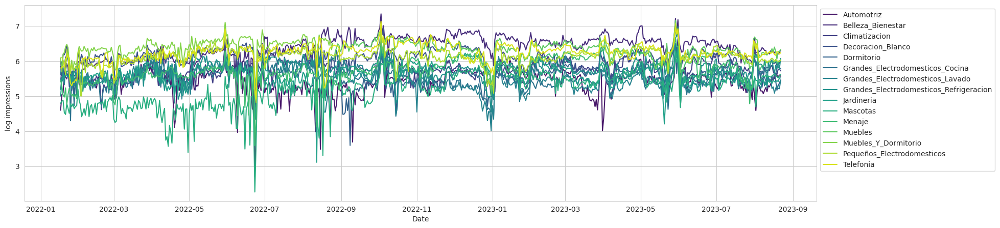

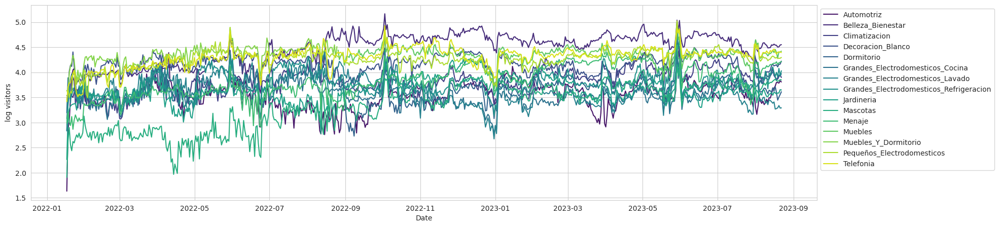

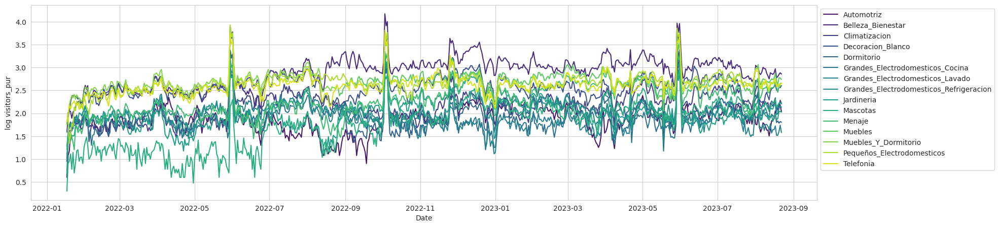

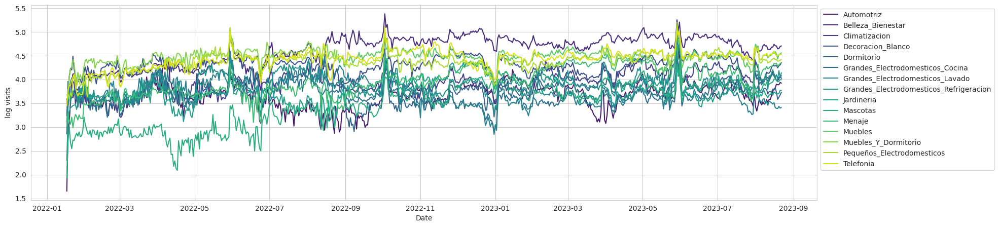

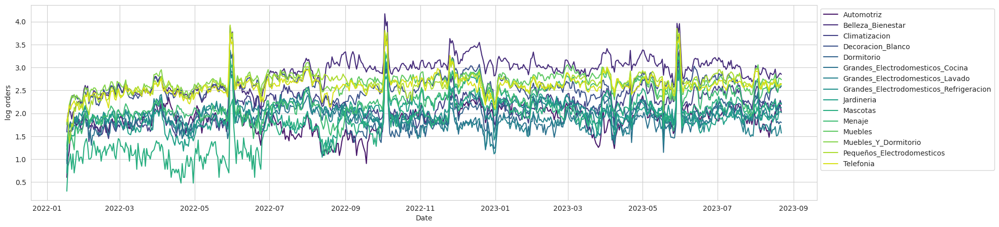

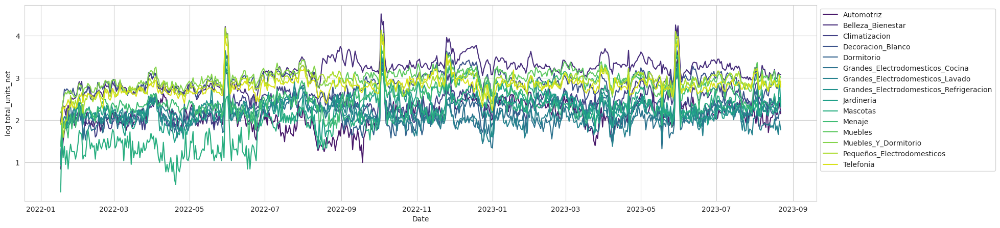

In [ ]:
# Get unique campaigns
unique_campaigns = df_raw['campaign'].unique()

# Set the style of seaborn for a white grid
sns.set_style('whitegrid')

for i, var in enumerate(variables):
    # Create a single plot
    fig, ax = plt.subplots(figsize=(20, 5))

    # Iterate over each campaign and plot its visits
    for i, campaign in enumerate(unique_campaigns):
        df = df_raw[df_raw['campaign'] == campaign]
        df.reset_index(inplace=True)

        # Set the color palette
        palette = 'viridis'

        ax.plot(df['date'], np.log10(1.0 + df[var]), label=campaign, color=sns.color_palette(palette, 15)[i])  # Each campaign in a different color

    # Set labels and title
    ax.set_xlabel('Date')
    ax.set_ylabel(f'log {var}')

    # Add legend to distinguish the campaigns
    ax.legend(loc='upper left', bbox_to_anchor=(1, 1), markerscale=0.5)


    # Show the plot
    plt.show()

#### VISITS distribution over time by campaign - _Format matrix_

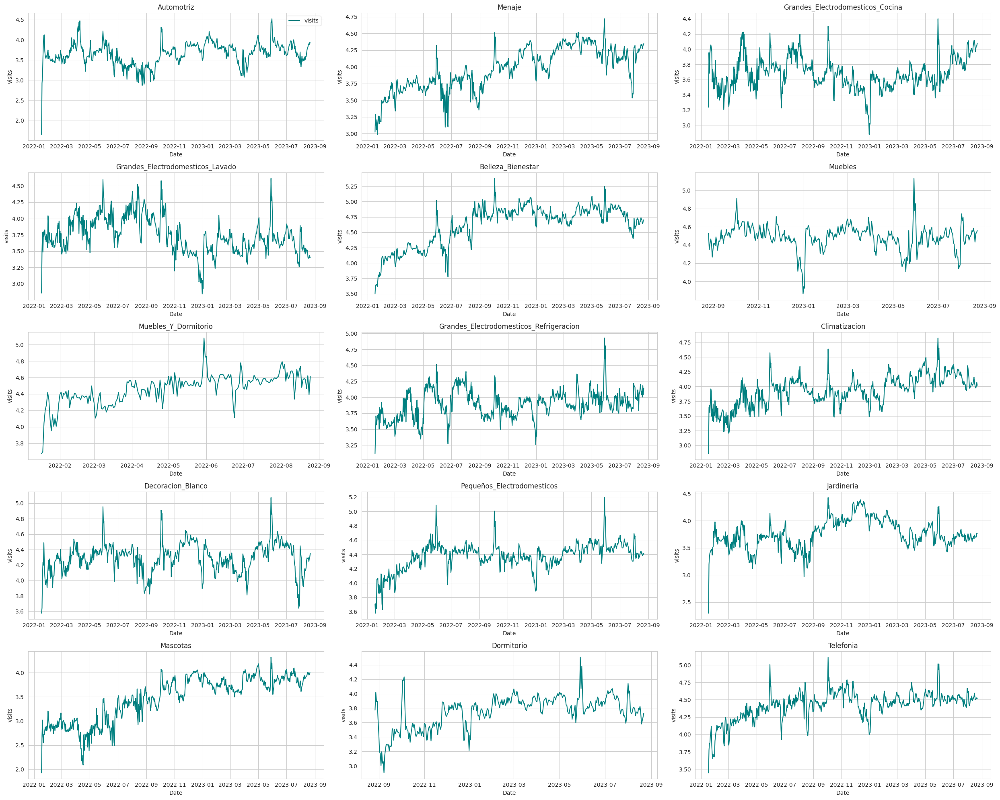

In [ ]:
# Define variable to plot
x_='visits'
x_label = 'visits'


cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(25,20))

for i, campaign in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)

    df = df_raw[(df_raw['campaign']==campaign)]
    df.reset_index(inplace=True)

    axs[j,k].set_title(campaign)
    # I want the legend only in the 1rst graph
    if (j==0)&(k==0):
        axs[j,k].plot(df.date, np.log10(1.0+df[x_]), label= f'{x_}', color='teal')
        axs[j,k].legend()
    else:
        axs[j,k].plot(df.date, np.log10(1.0+df[x_]), color='teal')

    axs[j,k].set_xlabel('Date')
    axs[j,k].set_ylabel(f'{x_}')
    axs[j,k].grid(True)

plt.tight_layout()

#### VISITS distribution over time by campaign - _Format list_

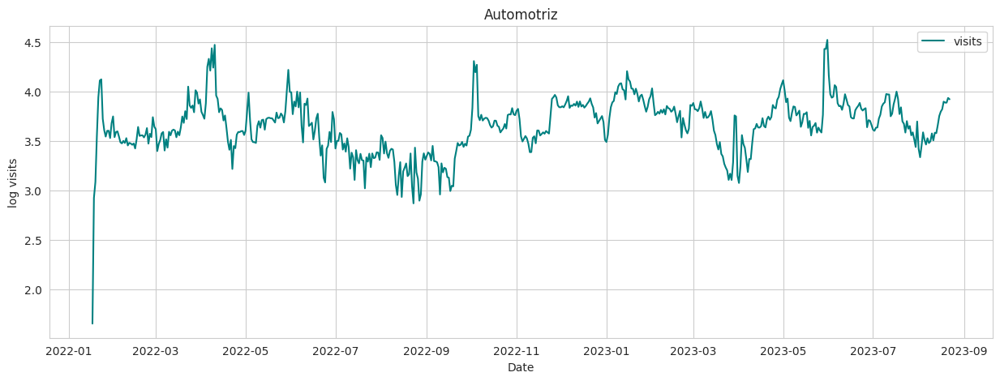

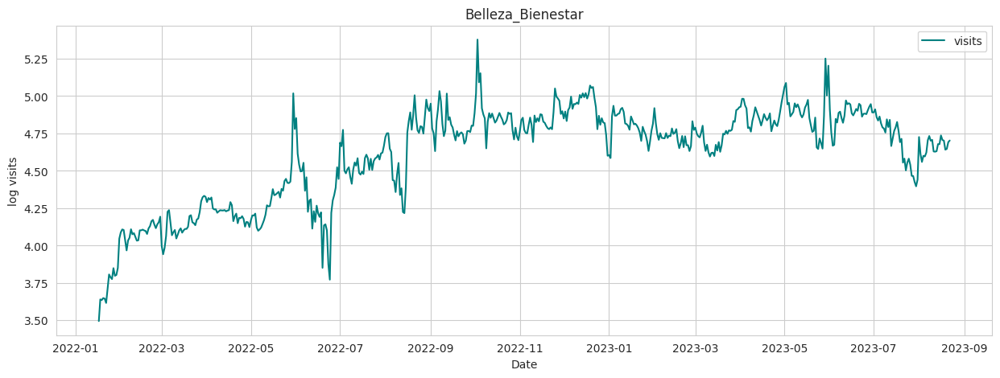

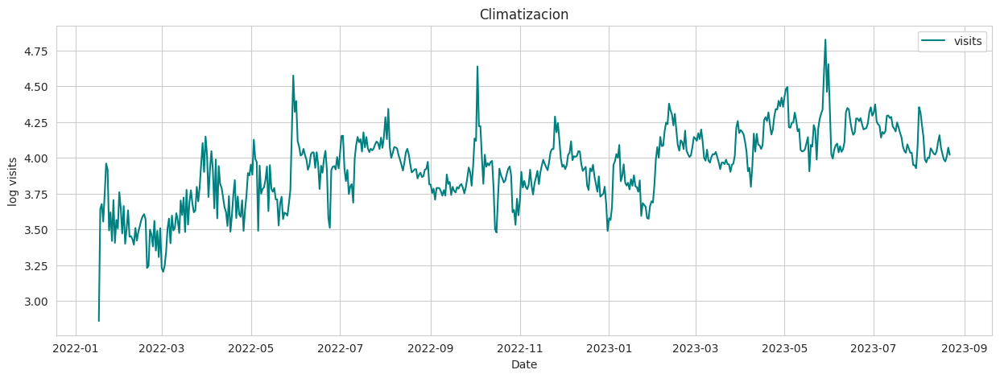

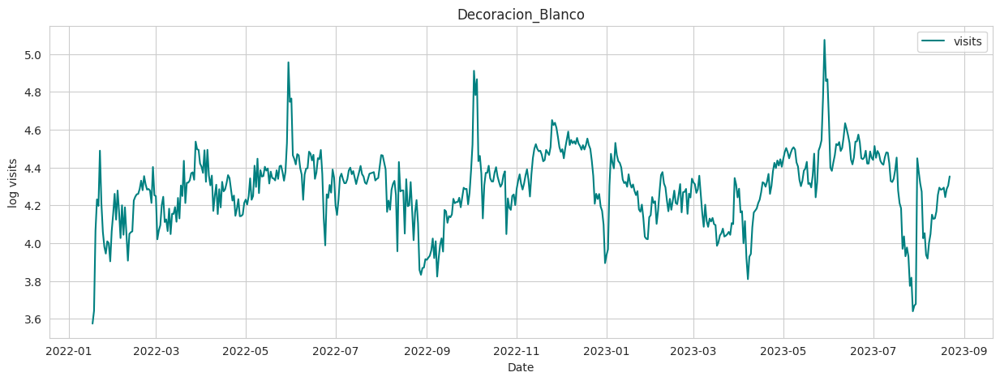

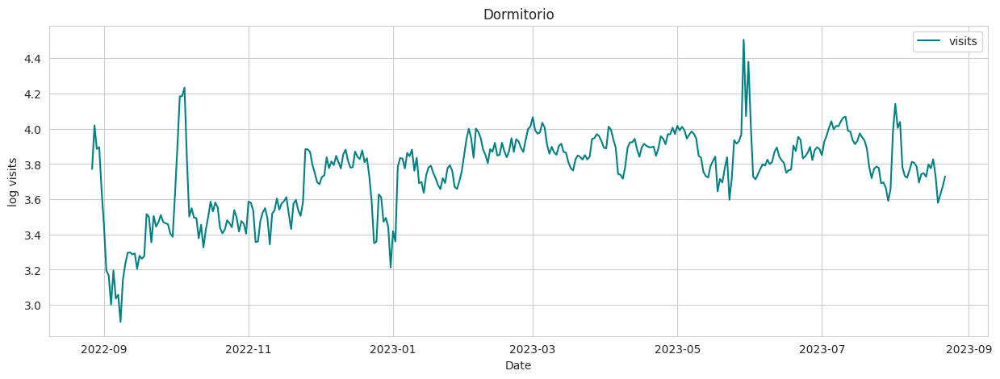

...

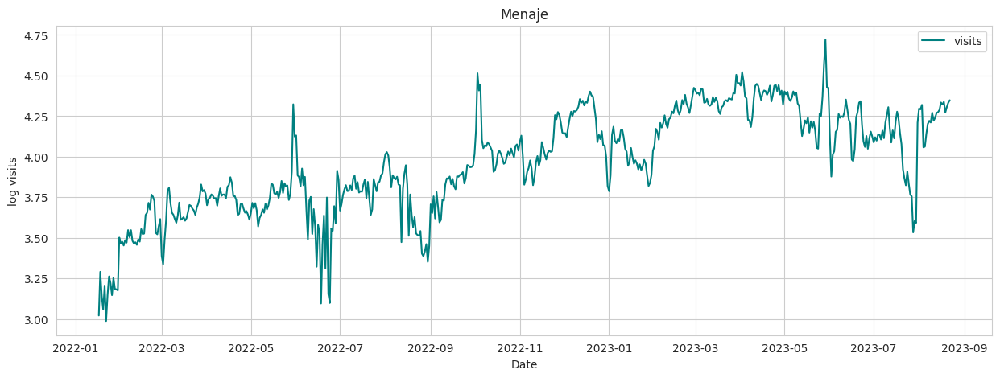

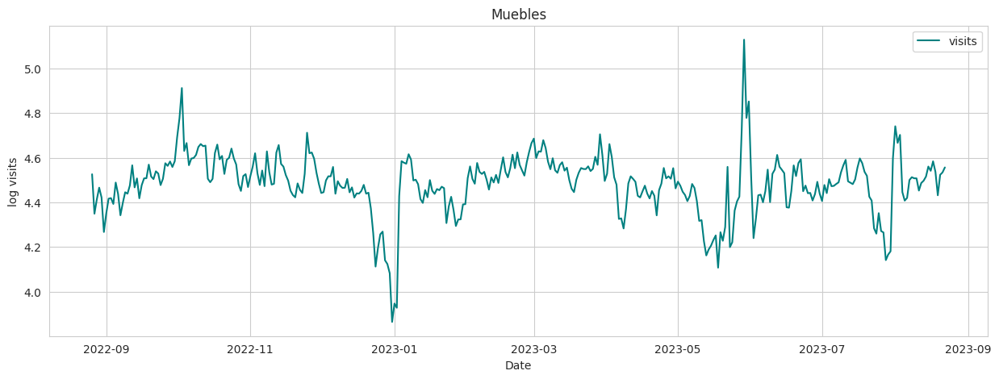

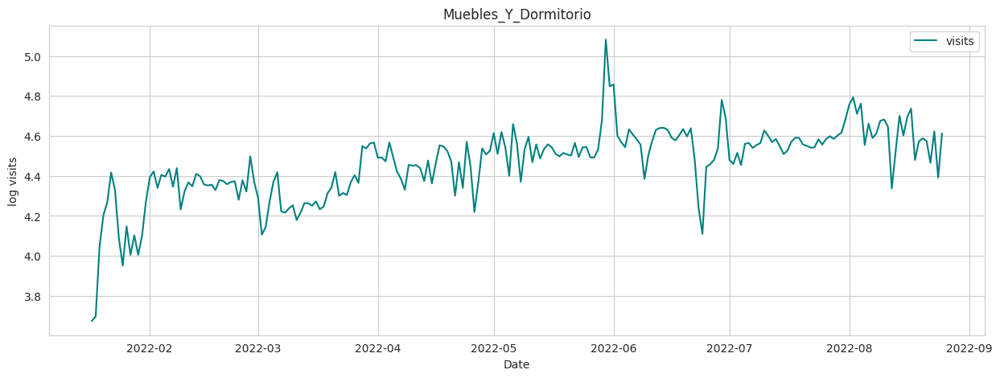

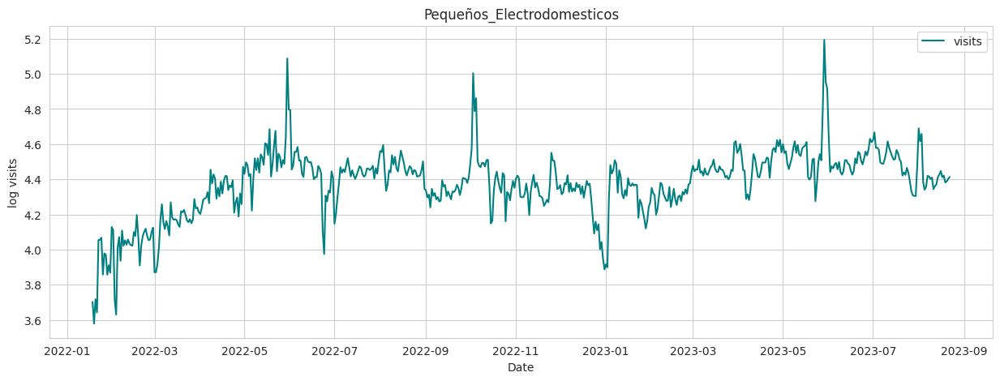

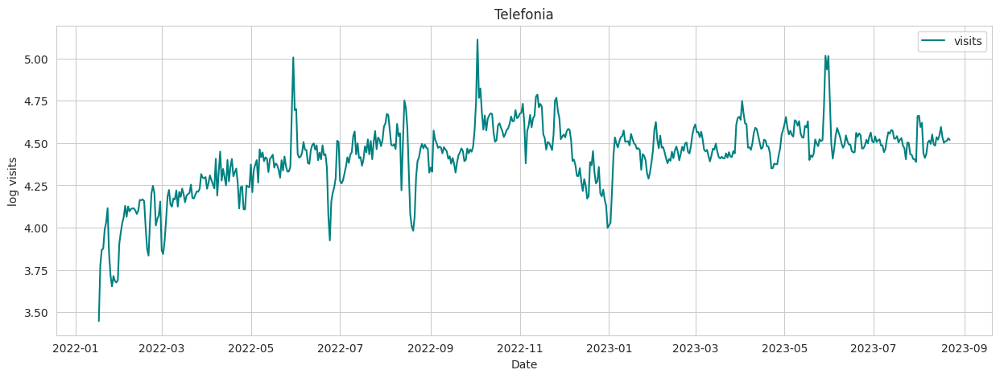

In [ ]:
# Define variable to plot
x_='visits'
x_label = 'visits'


cols = 3
rows = 5

for i, campaign in enumerate([*df_raw.campaign.unique()]):
    fig, axs = plt.subplots(1, 1, figsize=(15,5))

    df = df_raw[(df_raw['campaign']==campaign)]
    df.reset_index(inplace=True)

    axs.set_title(campaign)
    # I want the legend only in the 1rst graph
    axs.plot(df.date, np.log10(1.0+df[x_]), label= f'{x_}', color='teal')
    axs.legend()

    #axs[j,k].set_xlabel('Date')
    #axs[j,k].set_ylabel(f'log{x_}')
    #axs[j,k].grid(True)

    plt.xlabel('Date')
    plt.ylabel(f'log {x_}')
    plt.title(campaign)

    # Show the plot
    plt.show()

#### VISITS and CLICKS over time by campaign

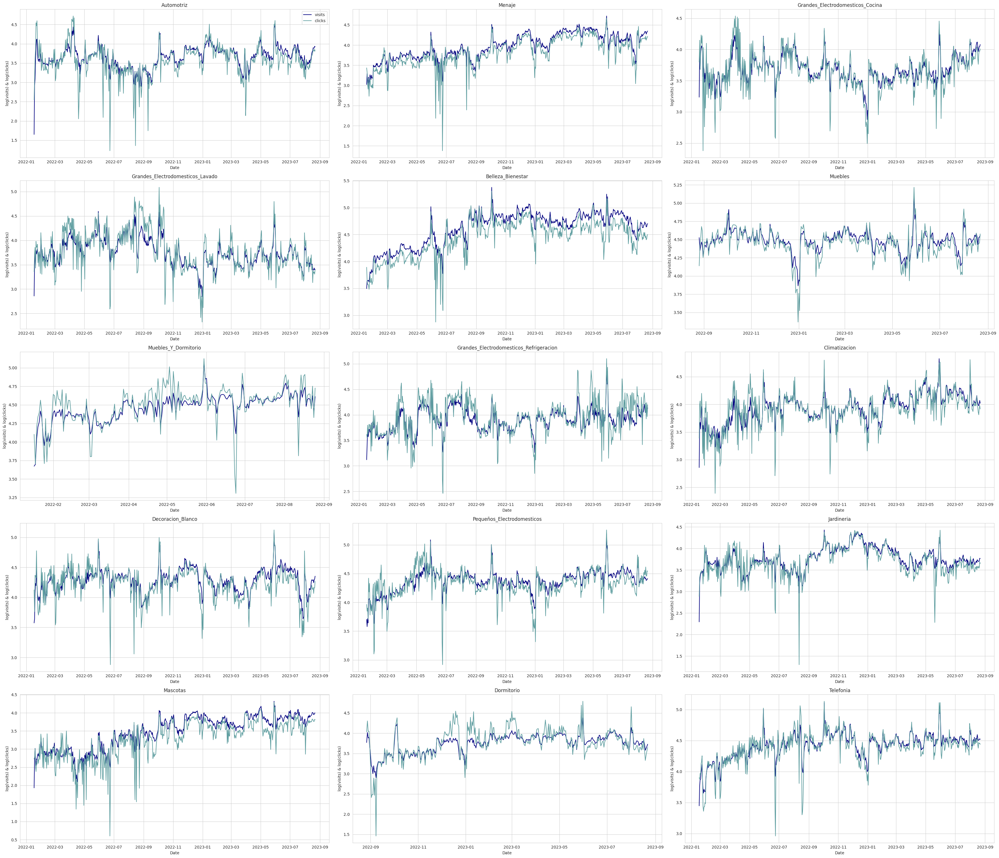

In [ ]:
x_='visits'
x_label = 'visits'
z_='clicks'
z_label = 'clicks'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(35,30))

for i, campaign in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    df = df_raw[(df_raw['campaign']==campaign)]
    df.reset_index(inplace=True)

    axs[j,k].set_title(campaign)
    # I want the legend only in the 1rst graph
    if (j==0)&(k==0):
        axs[j,k].plot(df.date, np.log10(1.0+df[x_]), label= x_label, color='navy')
        #axs[j,k].scatter(df.date, np.log10(1.0+df[x_]), s=10, color='navy')
        axs[j,k].plot(df.date, np.log10(1.0+df[z_]), label= z_label, color='cadetblue')
        #axs[j,k].scatter(df.date, np.log10(1.0+df[z_]), s=10, color='cadetblue')
        axs[j,k].legend()
    else:
        axs[j,k].plot(df.date, np.log10(1.0+df[x_]), color='navy')
        #axs[j,k].scatter(df.date, np.log10(1.0+df['x_']), s=10, color='navy')
        axs[j,k].plot(df.date, np.log10(1.0+df[z_]), color='cadetblue')
        #axs[j,k].scatter(df.date, np.log10(1.0+df[z_]), s=10, color='cadetblue')
    axs[j,k].set_xlabel('Date')
    axs[j,k].set_ylabel(f'log({x_}) & log({z_})')
    axs[j,k].grid(True)
plt.tight_layout()

#### Google Ads COST and Mkt Performance Team BUDGET


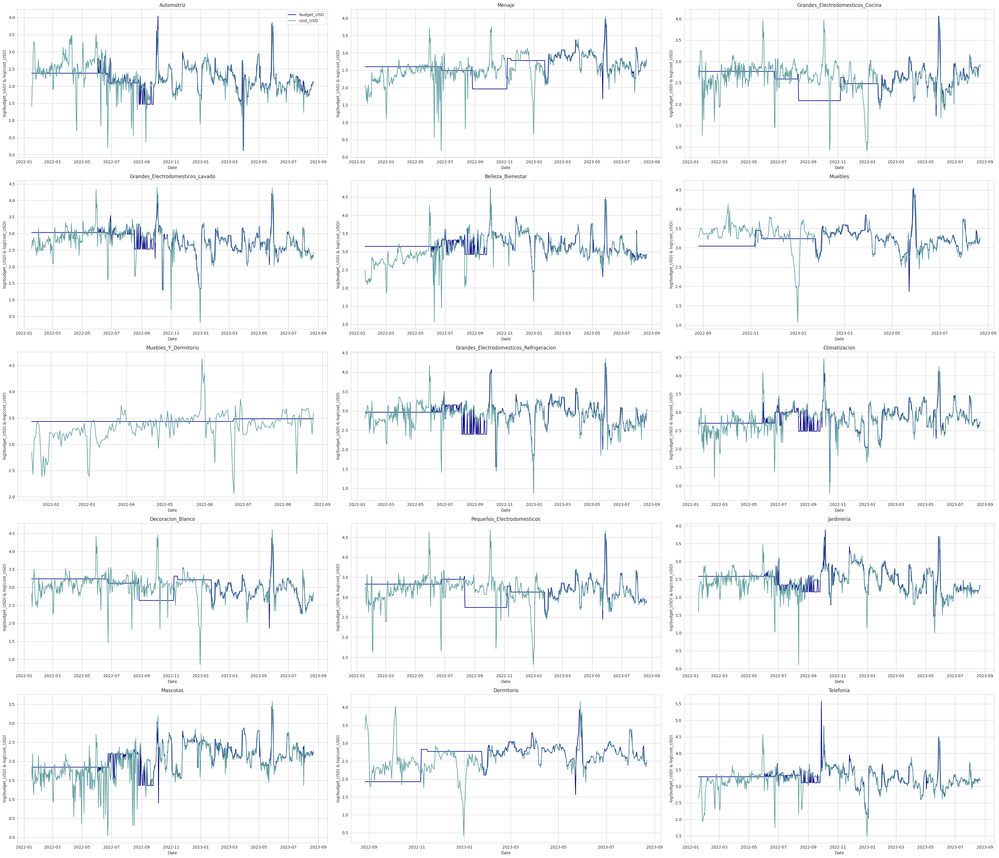

In [ ]:
x_='budget_USD'
x_label = 'budget_USD'
z_='cost_USD'
z_label = 'cost_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(35,30))

for i, campaign in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    df = df_raw[(df_raw['campaign']==campaign)]
    df.reset_index(inplace=True)

    axs[j,k].set_title(campaign)
    # I want the legend only in the 1rst graph
    if (j==0)&(k==0):
        axs[j,k].plot(df.date, np.log10(1.0+df[x_]), label= x_label, color='navy')
        #axs[j,k].scatter(df.date, np.log10(1.0+df[x_]), s=10, color='navy')
        axs[j,k].plot(df.date, np.log10(1.0+df[z_]), label= z_label, color='cadetblue')
        #axs[j,k].scatter(df.date, np.log10(1.0+df[z_]), s=10, color='cadetblue')
        axs[j,k].legend()
    else:
        axs[j,k].plot(df.date, np.log10(1.0+df[x_]), color='navy')
        #axs[j,k].scatter(df.date, np.log10(1.0+df['x_']), s=10, color='navy')
        axs[j,k].plot(df.date, np.log10(1.0+df[z_]), color='cadetblue')
        #axs[j,k].scatter(df.date, np.log10(1.0+df[z_]), s=10, color='cadetblue')
    axs[j,k].set_xlabel('Date')
    axs[j,k].set_ylabel(f'log({x_}) & log({z_})')
    axs[j,k].grid(True)
plt.tight_layout()

#### BUDGET distribution by campaign and event days

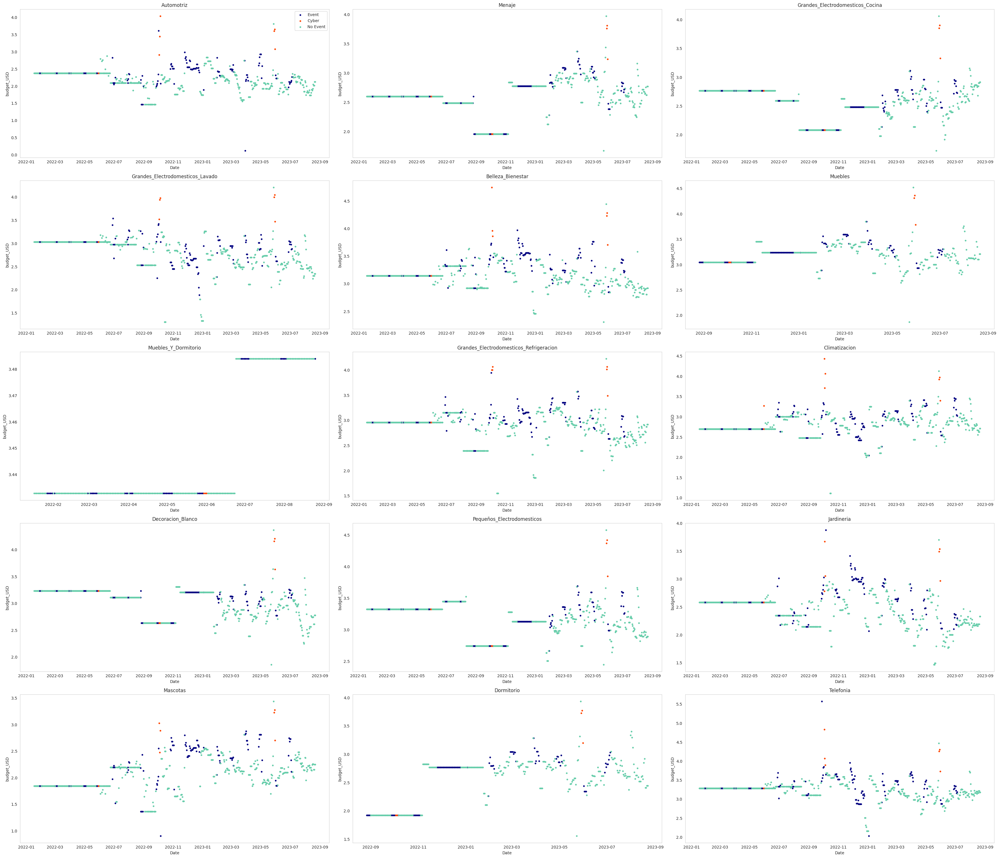

In [ ]:
x_='budget_USD'
x_label = 'budget_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(35,30))

for i, campaign in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    #df = df_raw[(df_raw['campaign']==campaign)&(df_raw['is_cyber']==0)&(df_raw['cost']>0)]
    df = df_raw[(df_raw['campaign']==campaign)]
    df.reset_index(inplace=True)

    dfev=df[(df.is_event==1)&(df.is_cyber==0)]
    dfcy=df[df.is_cyber==1]
    dfne=df[df.is_event==0]

    axs[j,k].set_title(campaign)
    if (j==0)&(k==0):
        axs[j,k].scatter(dfev.date, np.log10(1.0 + dfev[x_label]), s=10, color='navy', label='Event')
        axs[j,k].scatter(dfcy.date, np.log10(1.0 + dfcy[x_label]), s=10, color='orangered', label='Cyber')
        axs[j,k].scatter(dfne.date, np.log10(1.0 + dfne[x_label]), s=10, color='mediumaquamarine', label='No Event') #'cadetblue'
        axs[j,k].legend()
    else:
        if (j==0)&(k==1):
            axs[j,k].scatter(dfev.date, np.log10(1.0 + dfev[x_label]), s=10, color='navy')
            axs[j,k].scatter(dfcy.date, np.log10(1.0 + dfcy[x_label]), s=10, color='orangered')
            axs[j,k].scatter(dfne.date, np.log10(1.0 + dfne[x_label]), s=10, color='mediumaquamarine')
        else:
            axs[j,k].scatter(dfev.date, np.log10(1.0 + dfev[x_label]), s=10, color='navy')
            axs[j,k].scatter(dfcy.date, np.log10(1.0 + dfcy[x_label]), s=10, color='orangered')
            axs[j,k].scatter(dfne.date, np.log10(1.0 + dfne[x_label]), s=10, color='mediumaquamarine')
    axs[j,k].set_xlabel('Date')
    axs[j,k].set_ylabel(f'{x_label}')
    axs[j,k].grid()
plt.tight_layout()

#### Google Ads COST distribution by campaign and event days

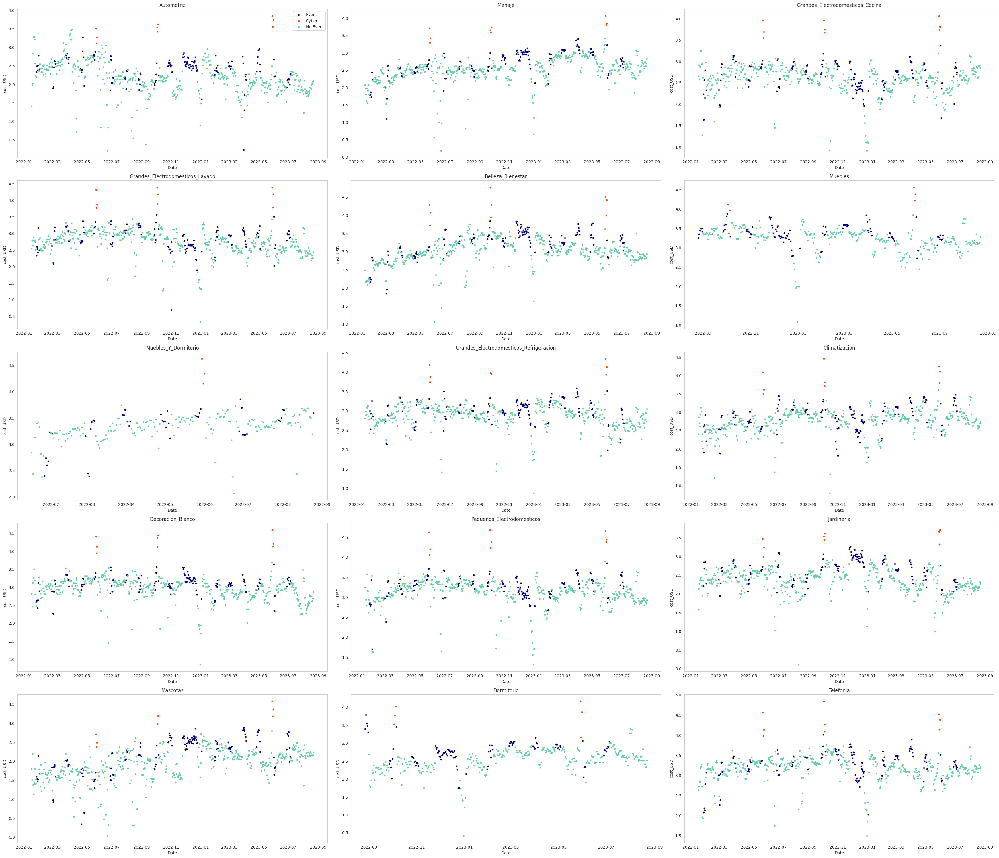

In [ ]:
x_='cost_USD'
x_label = 'cost_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(35,30))

for i, campaign in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    #df = df_raw[(df_raw['campaign']==campaign)&(df_raw['is_cyber']==0)&(df_raw['cost']>0)]
    df = df_raw[(df_raw['campaign']==campaign)]
    df.reset_index(inplace=True)

    dfev=df[(df.is_event==1)&(df.is_cyber==0)]
    dfcy=df[df.is_cyber==1]
    dfne=df[df.is_event==0]

    axs[j,k].set_title(campaign)
    if (j==0)&(k==0):
        axs[j,k].scatter(dfev.date, np.log10(1.0 + dfev[x_label]), s=10, color='navy', label='Event')
        axs[j,k].scatter(dfcy.date, np.log10(1.0 + dfcy[x_label]), s=10, color='orangered', label='Cyber')
        axs[j,k].scatter(dfne.date, np.log10(1.0 + dfne[x_label]), s=10, color='mediumaquamarine', label='No Event')
        axs[j,k].legend()
    else:
        if (j==0)&(k==1):
            axs[j,k].scatter(dfev.date, np.log10(1.0 + dfev[x_label]), s=10, color='navy')
            axs[j,k].scatter(dfcy.date, np.log10(1.0 + dfcy[x_label]), s=10, color='orangered')
            axs[j,k].scatter(dfne.date, np.log10(1.0 + dfne[x_label]), s=10, color='mediumaquamarine')
        else:
            axs[j,k].scatter(dfev.date, np.log10(1.0 + dfev[x_label]), s=10, color='navy')
            axs[j,k].scatter(dfcy.date, np.log10(1.0 + dfcy[x_label]), s=10, color='orangered')
            axs[j,k].scatter(dfne.date, np.log10(1.0 + dfne[x_label]), s=10, color='mediumaquamarine') #cadetblue
    axs[j,k].set_xlabel('Date')
    axs[j,k].set_ylabel(f'{x_label}')
    axs[j,k].grid()
plt.tight_layout()

#### NMV distribution by campaign and event days

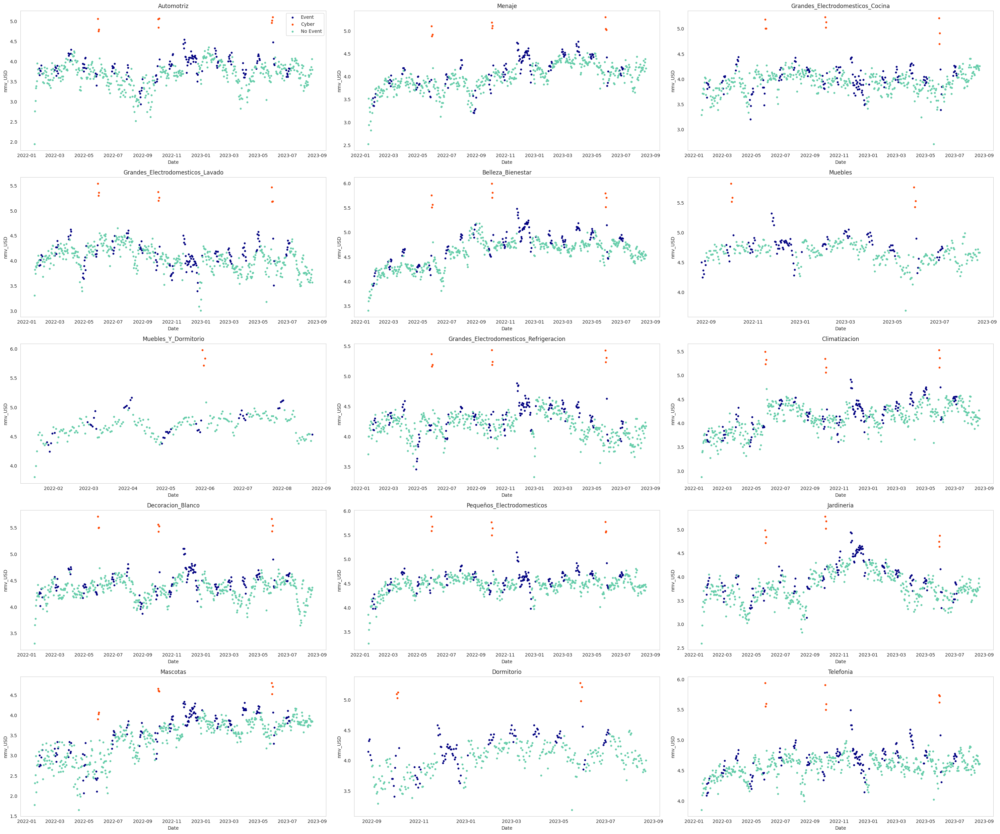

In [ ]:
x_='nmv_USD'
x_label = 'nmv_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(30,25))

for i, campaign in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    #df = df_raw[(df_raw['campaign']==campaign)&(df_raw['is_cyber']==0)&(df_raw['cost']>0)]
    df = df_raw[(df_raw['campaign']==campaign)]
    df.reset_index(inplace=True)

    dfev=df[(df.is_event==1)&(df.is_cyber==0)]
    dfcy=df[df.is_cyber==1]
    dfne=df[df.is_event==0]

    axs[j,k].set_title(campaign)
    if (j==0)&(k==0):
        axs[j,k].scatter(dfev.date, np.log10(1.0 + dfev[x_label]), s=10, color='navy', label='Event')
        axs[j,k].scatter(dfcy.date, np.log10(1.0 + dfcy[x_label]), s=10, color='orangered', label='Cyber')
        axs[j,k].scatter(dfne.date, np.log10(1.0 + dfne[x_label]), s=10, color='mediumaquamarine', label='No Event')
        axs[j,k].legend()
    else:
        if (j==0)&(k==1):
            axs[j,k].scatter(dfev.date, np.log10(1.0 + dfev[x_label]), s=10, color='navy')
            axs[j,k].scatter(dfcy.date, np.log10(1.0 + dfcy[x_label]), s=10, color='orangered')
            axs[j,k].scatter(dfne.date, np.log10(1.0 + dfne[x_label]), s=10, color='mediumaquamarine')
        else:
            axs[j,k].scatter(dfev.date, np.log10(1.0 + dfev[x_label]), s=10, color='navy')
            axs[j,k].scatter(dfcy.date, np.log10(1.0 + dfcy[x_label]), s=10, color='orangered')
            axs[j,k].scatter(dfne.date, np.log10(1.0 + dfne[x_label]), s=10, color='mediumaquamarine') #'teal'
    axs[j,k].set_xlabel('Date')
    axs[j,k].set_ylabel(f'{x_label}')
    axs[j,k].grid()
plt.tight_layout()

#### NMV distribution by campaign distinguishing by WEEKEND / WEEK day

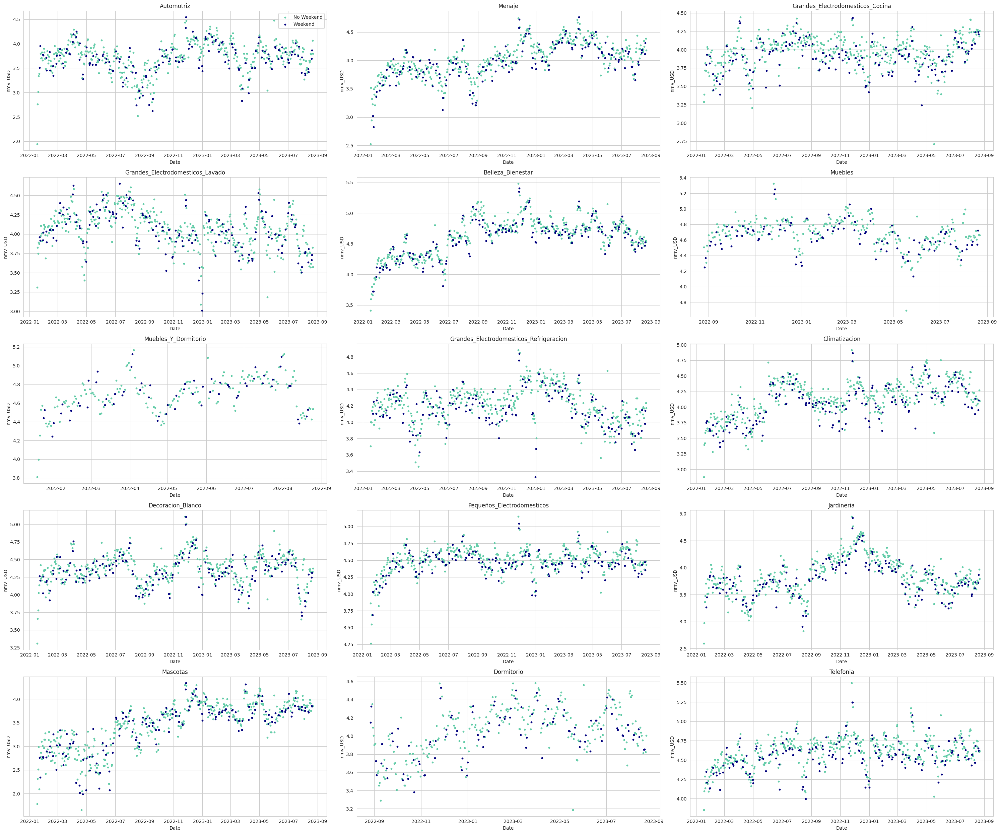

In [ ]:
x_='nmv_USD'
x_label = 'nmv_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(30,25))

for i, campaign in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    #df = df_raw[(df_raw['campaign']==campaign)&(df_raw['is_cyber']==0)&(df_raw['cost']>0)]
    df = df_raw[(df_raw['campaign']==campaign)]
    df.reset_index(inplace=True)

    dfnw=df[(df.is_week_day==1) & (df.is_cyber==0)]
    dfw=df[df.is_week_day==0 & (df.is_cyber==0)]

    axs[j,k].set_title(campaign)
    if (j==0)&(k==0):
        axs[j,k].scatter(dfnw.date, np.log10(1.0 + dfnw[x_label]), s=10, color='mediumaquamarine', label='No Weekend')
        axs[j,k].scatter(dfw.date, np.log10(1.0 + dfw[x_label]), s=10, color='navy', label='Weekend')
        axs[j,k].legend()
    else:
        if (j==0)&(k==1):
            axs[j,k].scatter(dfnw.date, np.log10(1.0 + dfnw[x_label]), s=10, color='mediumaquamarine')
            axs[j,k].scatter(dfw.date, np.log10(1.0 + dfw[x_label]), s=10, color='navy')
        else:
            axs[j,k].scatter(dfnw.date, np.log10(1.0 + dfnw[x_label]), s=10, color='mediumaquamarine') #'skyblue'
            axs[j,k].scatter(dfw.date, np.log10(1.0 + dfw[x_label]), s=10, color='navy')
    axs[j,k].set_xlabel('Date')
    axs[j,k].set_ylabel(f'{x_label}')
    axs[j,k].grid(True)
plt.tight_layout()

### Check NMV distribution by campaigns on WEEKENDS vs NON-WEEKENDS

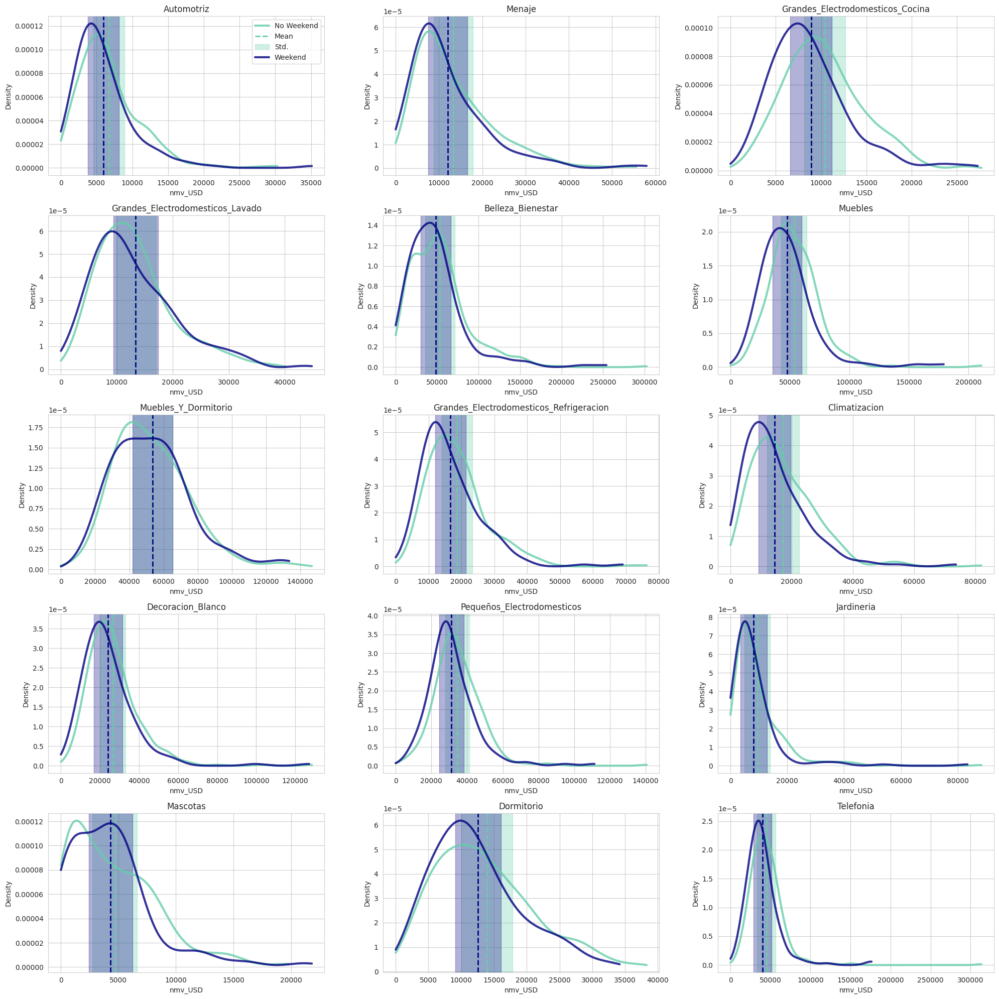

In [ ]:
x_='nmv_USD'
x_label = 'nmv_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,20))
fig.patch.set_facecolor('white')

for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    df = df_raw[(df_raw['campaign']==category)]
    #df = df_raw[(df_raw['category']==category)&(df_raw['is_cyber']==1)]
    dfe=df[(df.is_week_day==1)&(df.is_cyber==0)]
    dfc=df[df.is_cyber==1]
    dfne=df[(df.is_week_day==0)&(df.is_cyber==0)]
    #df.reset_index(inplace=True)
    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        v = dfe[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='mediumaquamarine', linewidth=3, alpha=0.8, label='No Weekend')
        axs[j,k].axvline(v.mean(), color='mediumaquamarine', linestyle='--', linewidth=2, label='Mean')
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.3, color='mediumaquamarine', label='Std.')

        v = dfne[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8, label='Weekend')
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.3, color='navy')
        axs[j,k].legend()
    else:
        v = dfe[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='mediumaquamarine', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='mediumaquamarine', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.3, color='mediumaquamarine') #'skyblue'
        v = dfne[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.3, color='navy')

    axs[j,k].set_xlabel(f'{x_label}')
    axs[j,k].set_ylabel('Density')
    axs[j,k].grid(True)
plt.tight_layout()

#### BUDGET distribution by campaigns on WEEKENDS vs NON-WEEKENDS


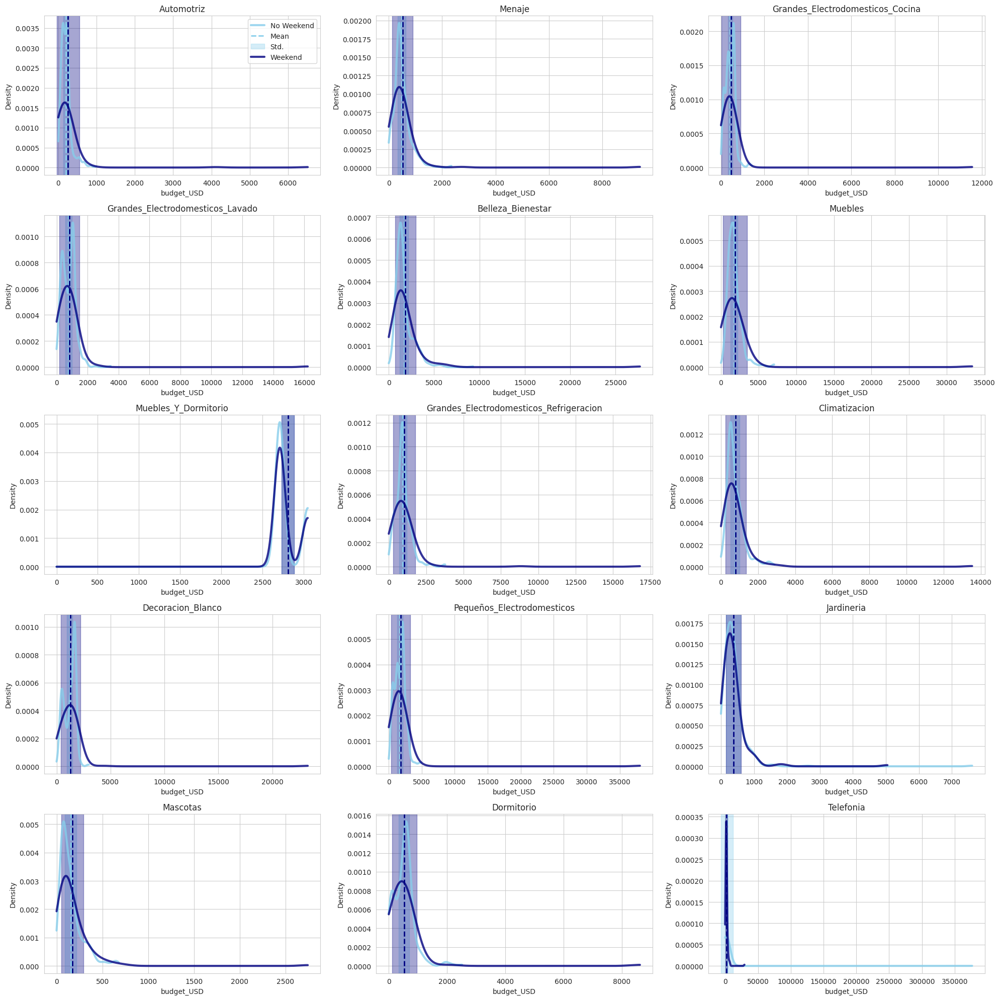

In [ ]:
x_='budget_USD'
x_label = 'budget_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,20))
fig.patch.set_facecolor('white')

for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    df = df_raw[(df_raw['campaign']==category)]
    #df = df_raw[(df_raw['category']==category)&(df_raw['is_cyber']==1)]
    dfe=df[(df.is_week_day==1)&(df.is_cyber==0)]
    dfc=df[df.is_cyber==1]
    dfne=df[(df.is_week_day==0)&(df.is_cyber==0)]
    #df.reset_index(inplace=True)
    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        v = dfe[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='skyblue', linewidth=3, alpha=0.8, label='No Weekend')
        axs[j,k].axvline(v.mean(), color='skyblue', linestyle='--', linewidth=2, label='Mean')
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.35, color='skyblue', label='Std.')

        v = dfne[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8, label='Weekend')
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.35, color='navy')
        axs[j,k].legend()
    else:
        v = dfe[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='skyblue', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='skyblue', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.35, color='skyblue')
        v = dfne[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.35, color='navy')

    axs[j,k].set_xlabel(f'{x_label}')
    axs[j,k].set_ylabel('Density')
    axs[j,k].grid(True)
plt.tight_layout()

#### COST/CLICK by weekend/week day.
❗❗❗❗**NOTE:** *THIS GRAPHS ARE AFTER REMOVING CYBER DAYS*



#### Conversion Rate distribution by campaign on WEEKENDS vs NON-WEEKENDS

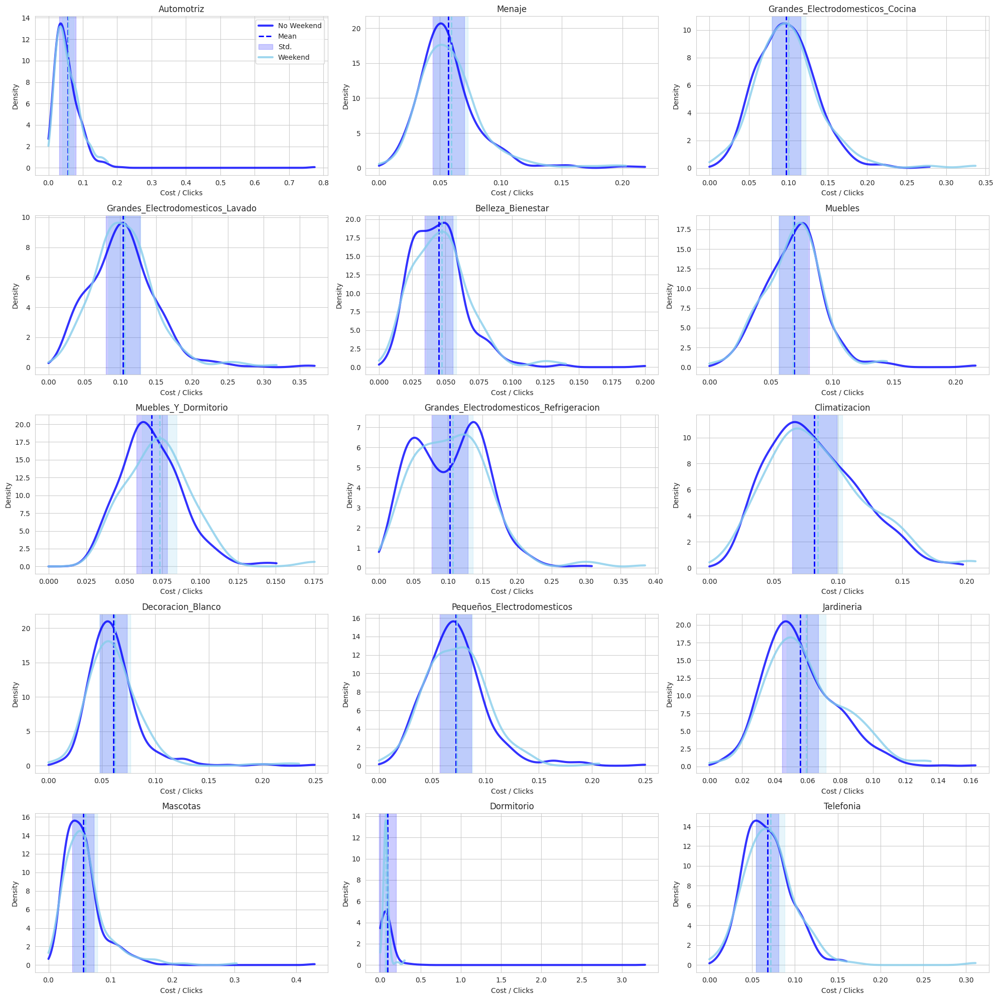

In [ ]:
x_='clicks'
x_label = 'clicks'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,20))
fig.patch.set_facecolor('white')
for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    df = df_raw[(df_raw['campaign']==category)&(df_raw['cost_USD']>0)]

    dfe=df[(df.is_week_day==1)&(df.is_cyber==0)]
    dfc=df[df.is_cyber==1]
    dfne=df[(df.is_week_day==0)&(df.is_cyber==0)]
    #df.reset_index(inplace=True)

    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        v = df[(df.is_week_day==1)&(df.is_cyber==0)]['cost_USD']/dfe[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='blue', linewidth=3, alpha=0.8, label='No Weekend')
        axs[j,k].axvline(v.mean(), color='blue', linestyle='--', linewidth=2, label='Mean')
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='blue', label='Std.')

        v = df[df.is_week_day==0]['cost_USD']/dfne[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='skyblue', linewidth=3, alpha=0.8, label='Weekend')
        axs[j,k].axvline(v.mean(), color='skyblue', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='skyblue')
        axs[j,k].legend()
    else:
        v = df[(df.is_week_day==1)&(df.is_cyber==0)]['cost_USD']/dfe[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='blue', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='blue', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='blue')

        v = df[df.is_week_day==0]['cost_USD']/dfne[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='skyblue', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='skyblue', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='skyblue')

    axs[j,k].set_xlabel('Cost / Clicks')
    axs[j,k].set_ylabel('Density')
    axs[j,k].grid(True)
plt.tight_layout()

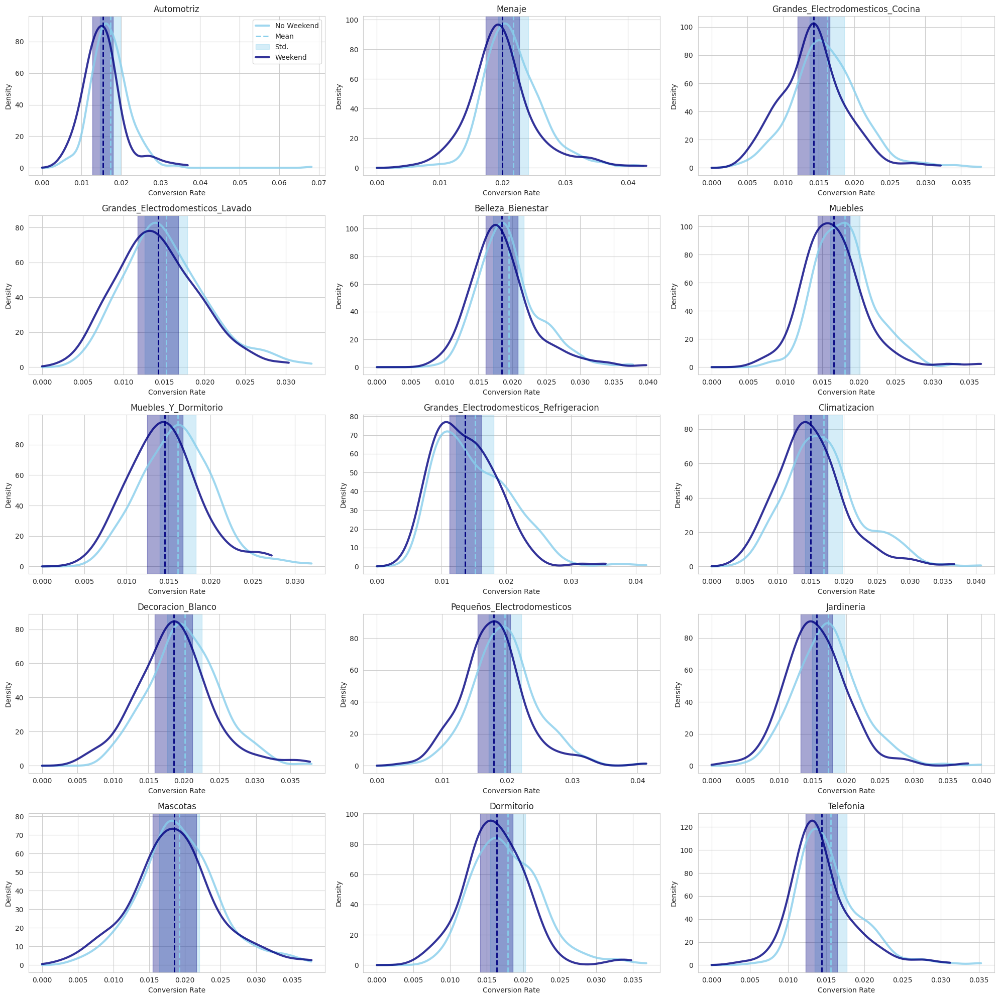

In [ ]:
x_='visits'
x_label = 'visits'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,20))
fig.patch.set_facecolor('white')

for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    df = df_raw[(df_raw['campaign']==category)&(df_raw['orders']>0)]

    dfev=df[(df.is_week_day==1)&(df.is_cyber==0)]
    dfcy=df[df.is_cyber==1]
    dfne=df[(df.is_week_day==0)&(df.is_cyber==0)]
    #df.reset_index(inplace=True)

    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        v = df[(df.is_week_day==1)&(df.is_cyber==0)]['orders']/dfev[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='skyblue', linewidth=3, alpha=0.8, label='No Weekend')
        axs[j,k].axvline(v.mean(), color='skyblue', linestyle='--', linewidth=2, label='Mean')
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.35, color='skyblue', label='Std.')

        v = df[df.is_week_day==0]['orders']/dfne[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8, label='Weekend')
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.35, color='navy')
        axs[j,k].legend()
    else:
        v = df[(df.is_week_day==1)&(df.is_cyber==0)]['orders']/dfev[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='skyblue', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='skyblue', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.35, color='skyblue')
        v = df[df.is_week_day==0]['orders']/dfne[x_label]
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.35, color='navy')

    axs[j,k].set_xlabel('Conversion Rate')
    axs[j,k].set_ylabel('Density')
    axs[j,k].grid(True)
plt.tight_layout()

#### IMPRESSIONS vs CLICKS

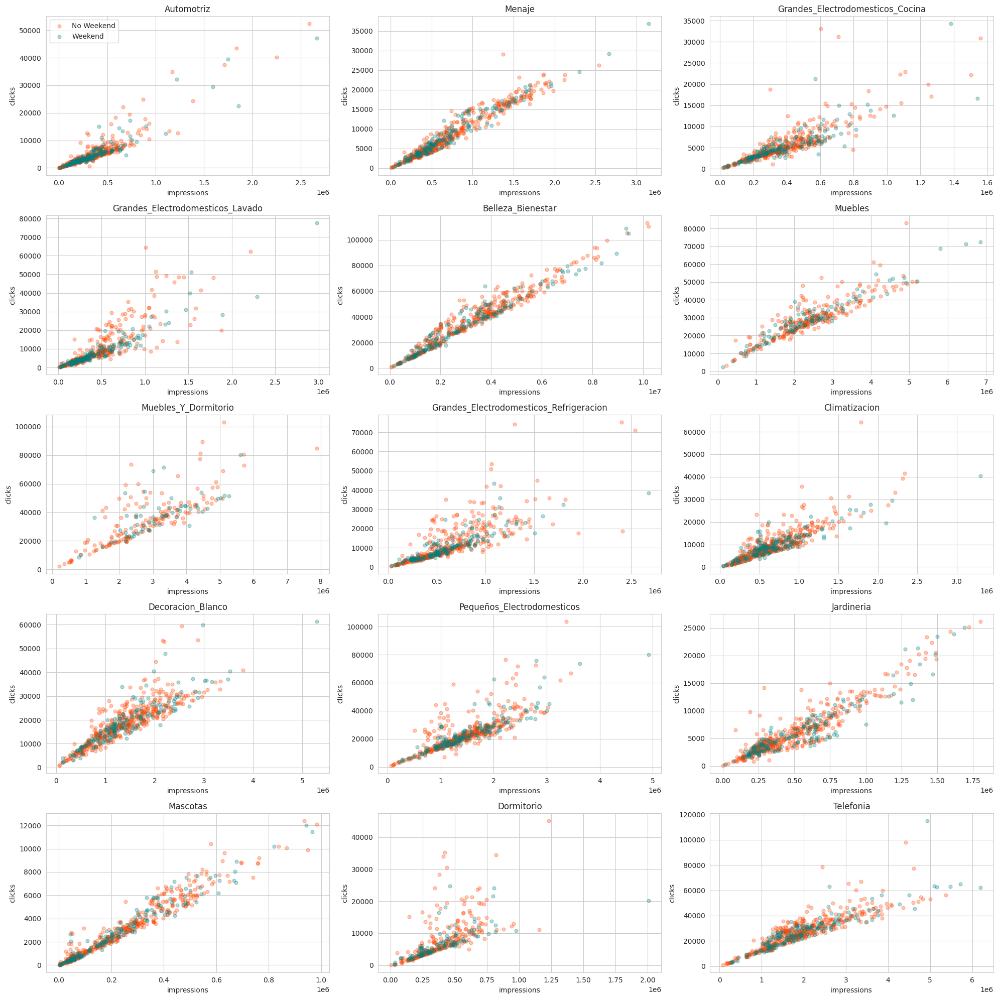

In [ ]:
q = 7

x_ = 'impressions'
x_label = 'impressions'
y_ = 'clicks'
y_label = 'clicks'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,20))
fig.patch.set_facecolor('white')

for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)

    df = df_raw[(df_raw['campaign'] == category)] #& (df_raw['cost_USD'] > 0)]
    df.dropna(inplace=True)

    dfe=df[(df.is_week_day==1)&(df.is_cyber==0)]
    dfc=df[df.is_cyber==1]
    dfne=df[(df.is_week_day==0)&(df.is_cyber==0)]
    #df.reset_index(inplace=True)
    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        axs[j,k].scatter(dfe[x_label],dfe[y_label], s=25, color='orangered', alpha=0.3, label='No Weekend')
        axs[j,k].scatter(dfne[x_label],dfne[y_label], s=25, color='teal', alpha=0.3, label='Weekend')
        axs[j,k].legend()
    else:
        axs[j,k].scatter(dfe[x_label],dfe[y_label], s=25, color='orangered', alpha=0.3)
        axs[j,k].scatter(dfne[x_label],dfne[y_label], s=25, color='teal', alpha=0.3)
    axs[j,k].set_xlabel(f'{x_}')
    axs[j,k].set_ylabel(f'{y_}')
    axs[j,k].grid(True)
plt.tight_layout()

**NOTE:**

Check also:
x_ = 'nmv_USD'
x_label = 'nmv_USD'
y_ = 'cost_USD'
y_label = 'cost_USD'

#### NMV distribution by campaign for CYBER, EVENT and NON-EVENT days

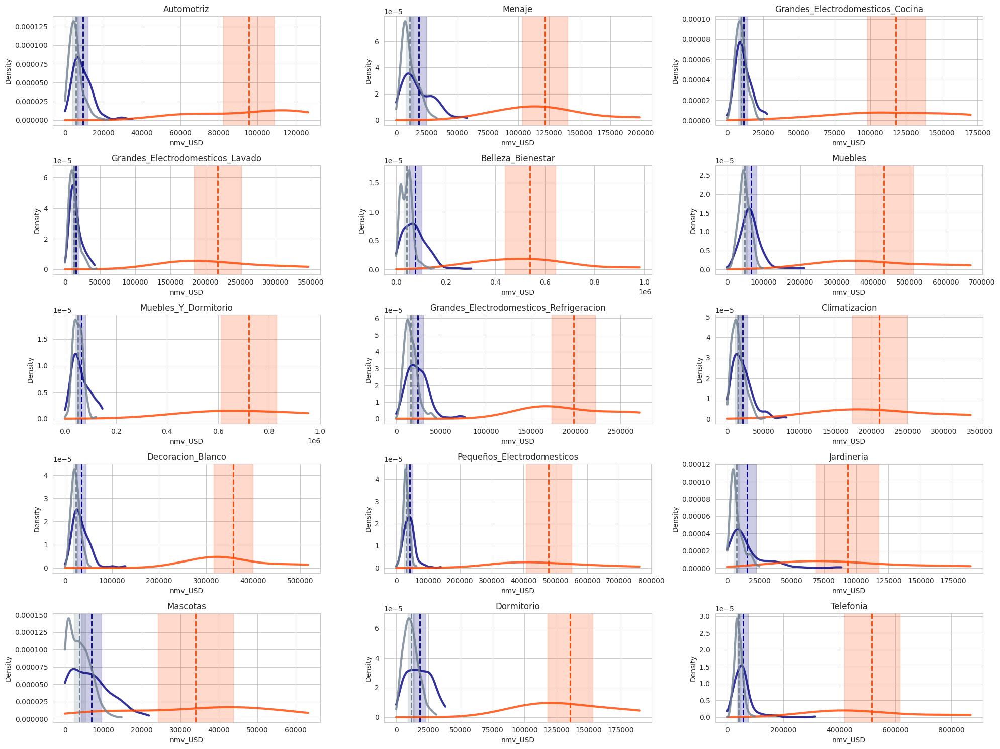

In [ ]:
x_ = 'nmv_USD'
x_label = 'nmv_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,15))
fig.patch.set_facecolor('white')

for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    df = df_raw[(df_raw['campaign']==category)]

    dfev=df[(df.is_event==1)&(df.is_cyber==0)]
    dfcy=df[df.is_cyber==1]
    dfne=df[df.is_event==0]
    #df.reset_index(inplace=True)

    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        v = dfev[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='blue', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8, label='Event')
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2, label='Mean')
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='navy', label='Std.')

        v = dfcy[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='green', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='orangered', linewidth=3, alpha=0.8, label='Cyber')
        axs[j,k].axvline(v.mean(), color='orangered', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='orangered')

        v = dfne[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='red', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='slategray', linewidth=3, alpha=0.8, label='No Event')
        axs[j,k].axvline(v.mean(), color='slategray', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='slategray')
        #axs[j,k].legend()
        ax.legend(loc='upper left', bbox_to_anchor=(1, 1), markerscale=0.5)
    else:
        v = dfev[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='blue', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='navy')

        v = dfcy[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='green', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='orangered', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='orangered', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='orangered')

        v = dfne[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='red', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='slategray', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='slategray', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='slategray')

    axs[j,k].set_xlabel(f'{x_}')
    axs[j,k].set_ylabel('Density')
    axs[j,k].grid(True)
plt.tight_layout()



---


Using the following we can review the CTR:
x_='clicks'
x_label = 'clicks'
y_='impressions'
y_label = 'impressions'

According to GAds, a CTR closed to 2% is good.

---



Same for AOV:
x_='orders'
x_label = 'orders'
y_='nmv_USD'
y_label = 'nmv_USD'

and

x_='total_units_net'
x_label = 'total_units_net'
y_='orders'
y_label = 'orders'

---

ROAS using:
x_='nmv_USD'
x_label = 'nmv_USD'
y_='budget_USD'
y_label = 'budget_USD'

(For C/V add "*100")

---



#### Google Ads COST distribution by campaign for CYBER, EVENT and NON-EVENT days

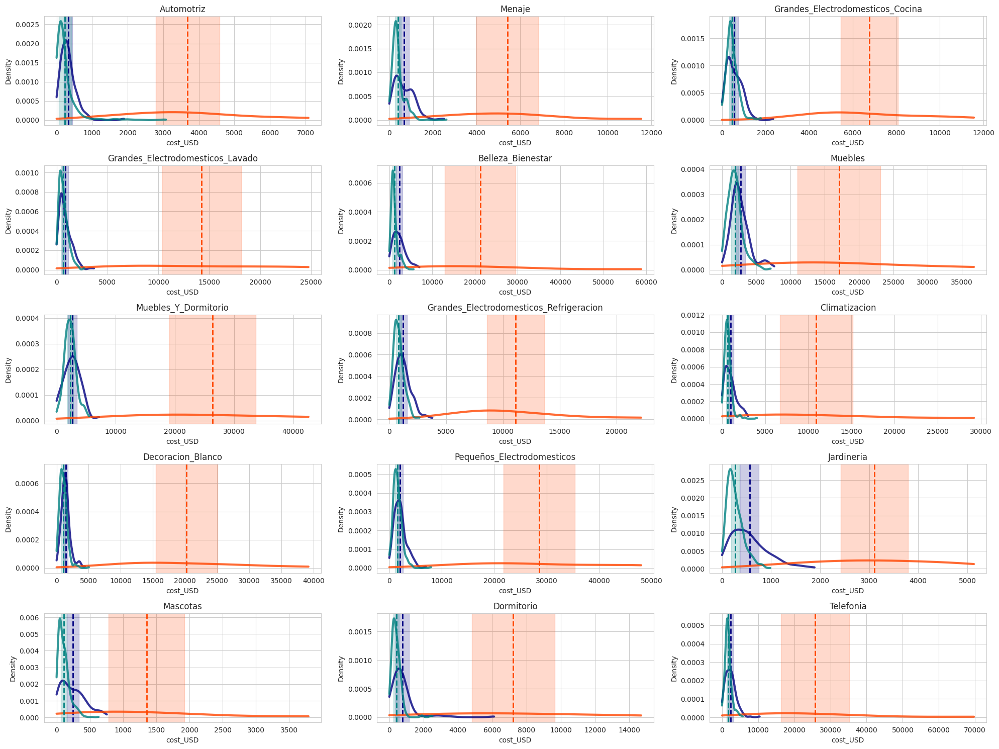

In [ ]:
x_ = 'cost_USD'
x_label = 'cost_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,15))
fig.patch.set_facecolor('white')

for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    df = df_raw[(df_raw['campaign']==category)]

    dfev=df[(df.is_event==1)&(df.is_cyber==0)]
    dfcy=df[df.is_cyber==1]
    dfne=df[df.is_event==0]
    #df.reset_index(inplace=True)

    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        v = dfev[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='blue', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8, label='Event')
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2, label='Mean')
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='navy', label='Std.')

        v = dfcy[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='green', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='orangered', linewidth=3, alpha=0.8, label='Cyber')
        axs[j,k].axvline(v.mean(), color='orangered', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='orangered')

        v = dfne[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='red', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='teal', linewidth=3, alpha=0.8, label='No Event')
        axs[j,k].axvline(v.mean(), color='teal', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='teal')
        #axs[j,k].legend()
        ax.legend(loc='upper left', bbox_to_anchor=(1, 1), markerscale=0.5)
    else:
        v = dfev[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='blue', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='navy')

        v = dfcy[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='green', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='orangered', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='orangered', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='orangered')

        v = dfne[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='red', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='teal', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='teal', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='teal')

    axs[j,k].set_xlabel(f'{x_}')
    axs[j,k].set_ylabel('Density')
    axs[j,k].grid(True)
plt.tight_layout()

#### ORDERS distribution by campaign for CYBER, EVENT and NON-EVENT days

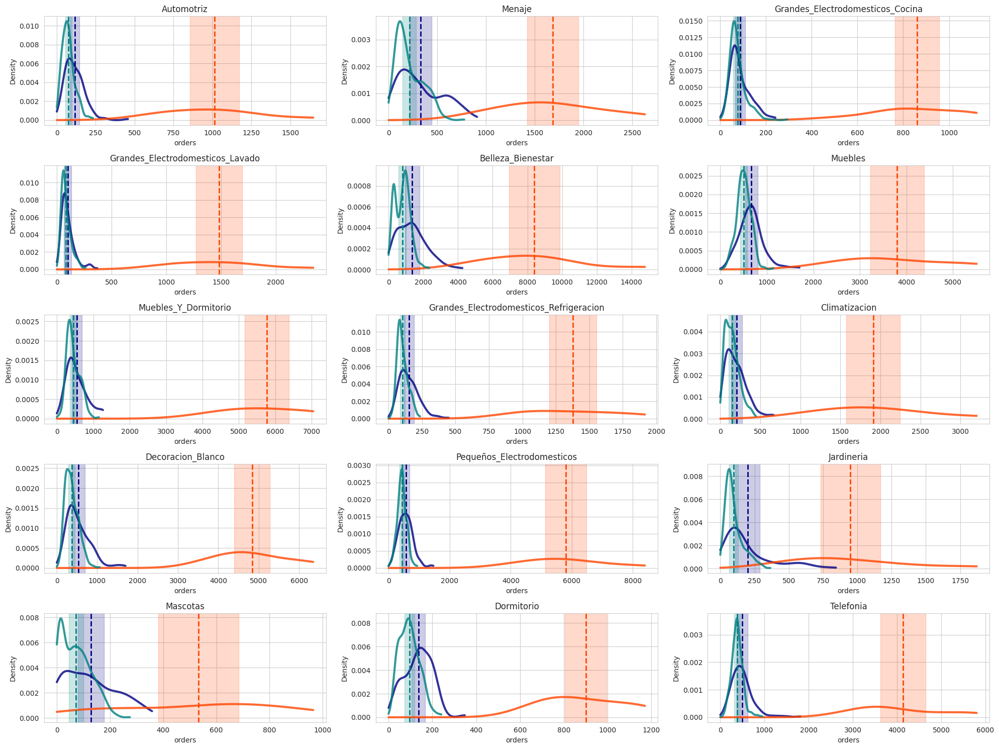

In [ ]:
x_ = 'orders'
x_label = 'orders'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,15))
fig.patch.set_facecolor('white')

for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    df = df_raw[(df_raw['campaign']==category)&(df_raw['budget_USD']>0)]

    dfev=df[(df.is_event==1)&(df.is_cyber==0)]
    dfcy=df[df.is_cyber==1]
    dfne=df[df.is_event==0]
    #df.reset_index(inplace=True)

    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        v = dfev[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='blue', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8, label='Event')
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2, label='Mean')
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='navy', label='Std.')

        v = dfcy[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='green', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='orangered', linewidth=3, alpha=0.8, label='Cyber')
        axs[j,k].axvline(v.mean(), color='orangered', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='orangered')

        v = dfne[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='red', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='teal', linewidth=3, alpha=0.8, label='No Event')
        axs[j,k].axvline(v.mean(), color='teal', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='teal')
        #axs[j,k].legend()
        ax.legend(loc='upper left', bbox_to_anchor=(1, 1), markerscale=0.5)
    else:
        v = dfev[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='blue', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='navy')

        v = dfcy[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='green', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='orangered', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='orangered', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='orangered')

        v = dfne[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='red', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='teal', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='teal', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='teal')

    axs[j,k].set_xlabel(f'{x_}')
    axs[j,k].set_ylabel('Density')
    axs[j,k].grid(True)

plt.tight_layout()
plt.show()

#### NMV distribution by campaign for CYBER, EVENT and NON-EVENT days



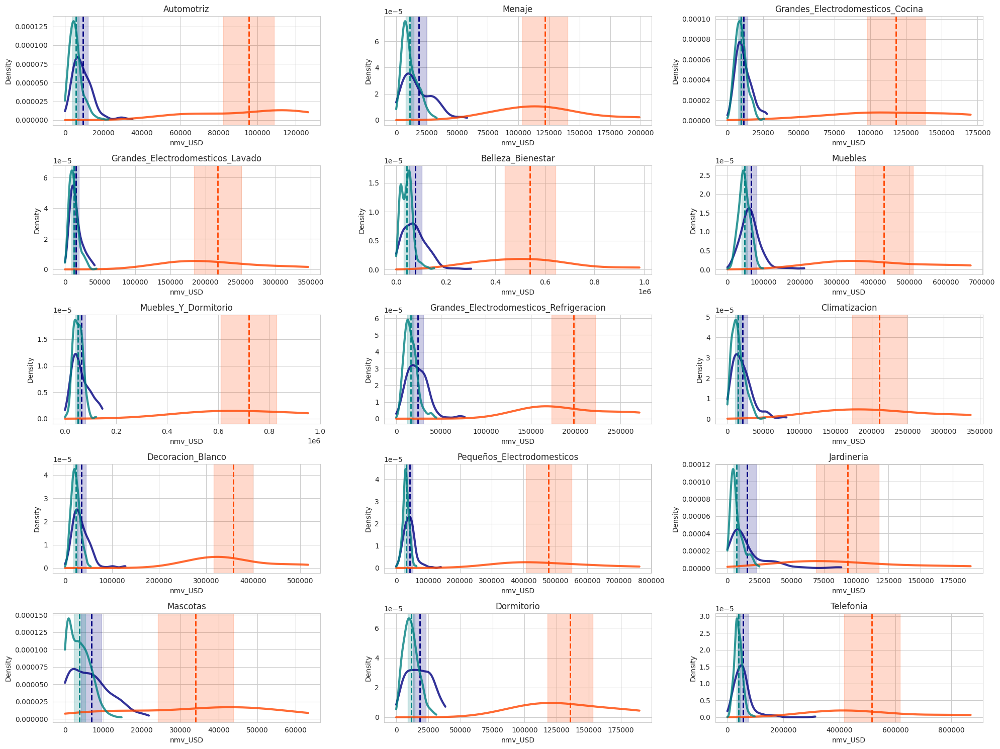

In [ ]:
x_ = 'nmv_USD'
x_label = 'nmv_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,15))
fig.patch.set_facecolor('white')

for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)
    df = df_raw[(df_raw['campaign']==category)&(df_raw['budget_USD']>0)]

    dfe=df[(df.is_event==1)&(df.is_cyber==0)]
    dfc=df[df.is_cyber==1]
    dfne=df[df.is_event==0]
    #df.reset_index(inplace=True)

    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        v = dfe[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='blue', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8, label='Event')
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2, label='Mean')
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='navy', label='Std.')

        v = dfc[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='green', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='orangered', linewidth=3, alpha=0.8, label='Cyber')
        axs[j,k].axvline(v.mean(), color='orangered', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='orangered')

        v = dfne[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='red', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='teal', linewidth=3, alpha=0.8, label='No Event')
        axs[j,k].axvline(v.mean(), color='teal', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='teal')
        #axs[j,k].legend()
        ax.legend(loc='upper left', bbox_to_anchor=(1, 1), markerscale=0.5)
    else:
        v = dfe[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='blue', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='navy')

        v = dfc[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='green', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='orangered', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='orangered', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='orangered')

        v = dfne[x_label]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='red', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='teal', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='teal', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='teal')

    axs[j,k].set_xlabel(f'{x_}')
    axs[j,k].set_ylabel('Density')
    axs[j,k].grid(True)
plt.tight_layout()
plt.show()

Conversion distribution by campaign for CYBER, EVENT and NON-EVENT days

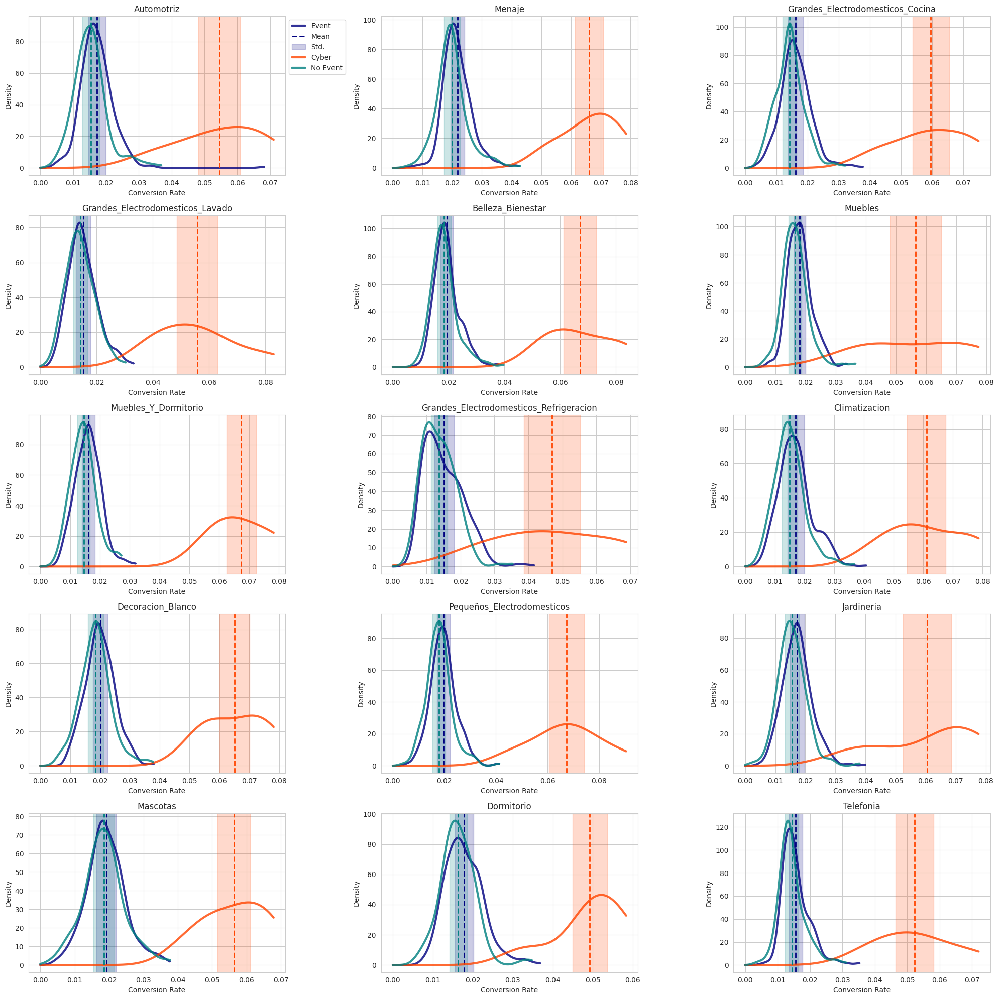

In [ ]:
x_='orders'
x_label = 'orders'
y_='visits'
y_label = 'visits'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,20))
fig.patch.set_facecolor('white')

for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)

    df = df_raw[(df_raw['campaign']==category)&(df_raw['orders']>0)]
    dfev=df[(df.is_week_day==1)&(df.is_cyber==0)]
    dfcy=df[df.is_cyber==1]
    dfne=df[(df.is_week_day==0)&(df.is_cyber==0)]
    #df.reset_index(inplace=True)

    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        v = dfev[x_]/dfev[y_]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='blue', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8, label='Event')
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2, label='Mean')
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='navy', label='Std.')

        v = dfcy[x_]/dfcy[y_]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='green', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='orangered', linewidth=3, alpha=0.8, label='Cyber')
        axs[j,k].axvline(v.mean(), color='orangered', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='orangered')

        v = dfne[x_]/dfne[y_]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='red', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='teal', linewidth=3, alpha=0.8, label='No Event')
        axs[j,k].axvline(v.mean(), color='teal', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='teal')
        #axs[j,k].legend()
        axs[j,k].legend(loc='upper left', bbox_to_anchor=(1, 1), markerscale=0.5)
    else:
        v = dfev[x_]/dfev[y_]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='blue', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='navy', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='navy', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='navy')

        v = dfcy[x_]/dfcy[y_]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='green', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='orangered', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='orangered', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='orangered')

        v = dfne[x_]/dfne[y_]
        #_ = axs[j,k].hist(v, bins=20, density=True, color='red', alpha=0.2)
        kde = stats.gaussian_kde(v.values)
        xx = np.linspace(0, max(v), 1000)
        _ = axs[j,k].plot(xx, kde(xx), color='teal', linewidth=3, alpha=0.8)
        axs[j,k].axvline(v.mean(), color='teal', linestyle='--', linewidth=2)
        axs[j,k].axvspan(v.mean()-v.std()/2, v.mean()+v.std()/2, alpha=0.2, color='teal')

    axs[j,k].set_xlabel('Conversion Rate')
    axs[j,k].set_ylabel('Density')
    axs[j,k].grid(True)
plt.tight_layout()

#### Scatter plots

#### For these we'll need to remove outliers because we can't see the data correctly

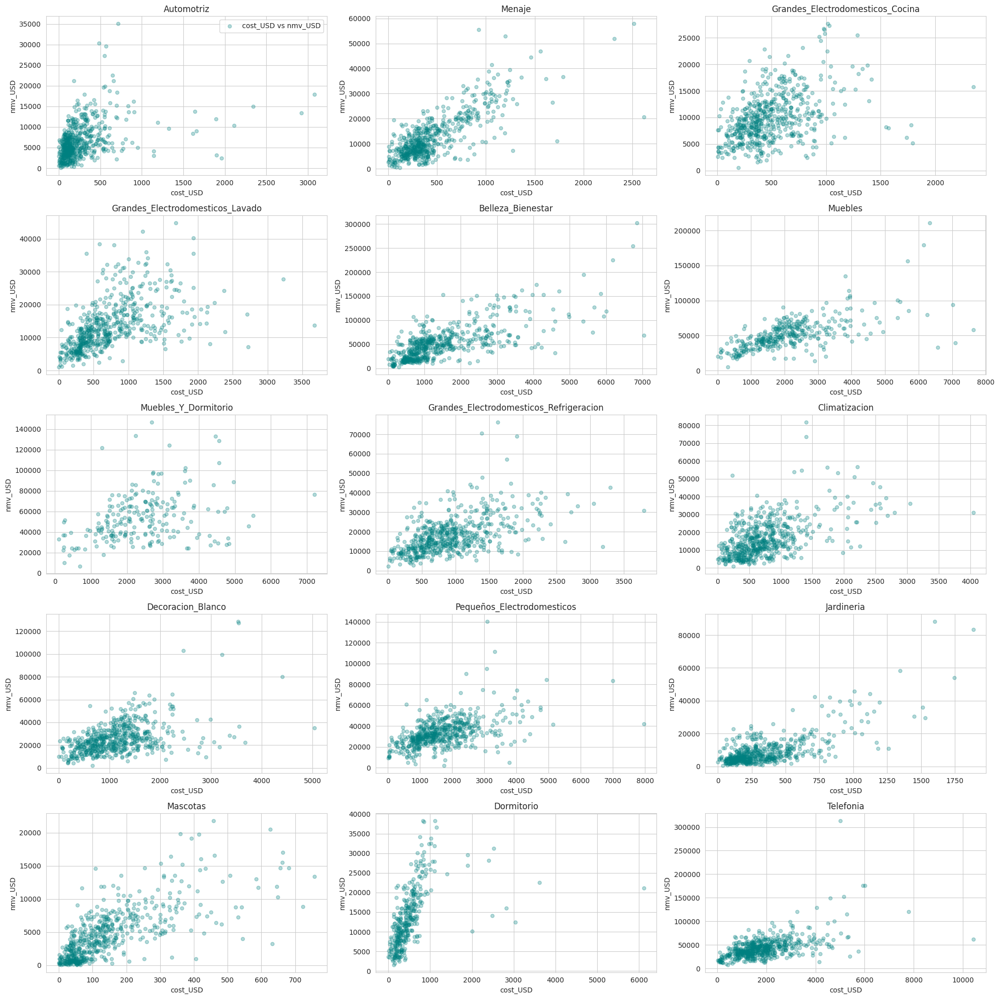

In [ ]:
q = 7
## With cost the graphs look better but budget....
x_ = 'cost_USD' #'budget_USD'
x_label = 'cost_USD'  #'budget_USD'
y_ = 'nmv_USD'
y_label = 'nmv_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(20,20))
fig.patch.set_facecolor('white')

for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)

    df = df_raw[(df_raw['campaign'] == category) & (df_raw.is_cyber==0)]
    df.dropna(inplace=True)

    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        axs[j,k].scatter(df[x_label],df[y_label], s=25, color='teal', alpha=0.3, label = f'{x_} vs {y_}')
        axs[j,k].legend()
    else:
        axs[j,k].scatter(df[x_label],df[y_label], s=25, color='teal', alpha=0.3)
    axs[j,k].set_xlabel(f'{x_}')
    axs[j,k].set_ylabel(f'{y_}')
    axs[j,k].grid(True)
plt.tight_layout()

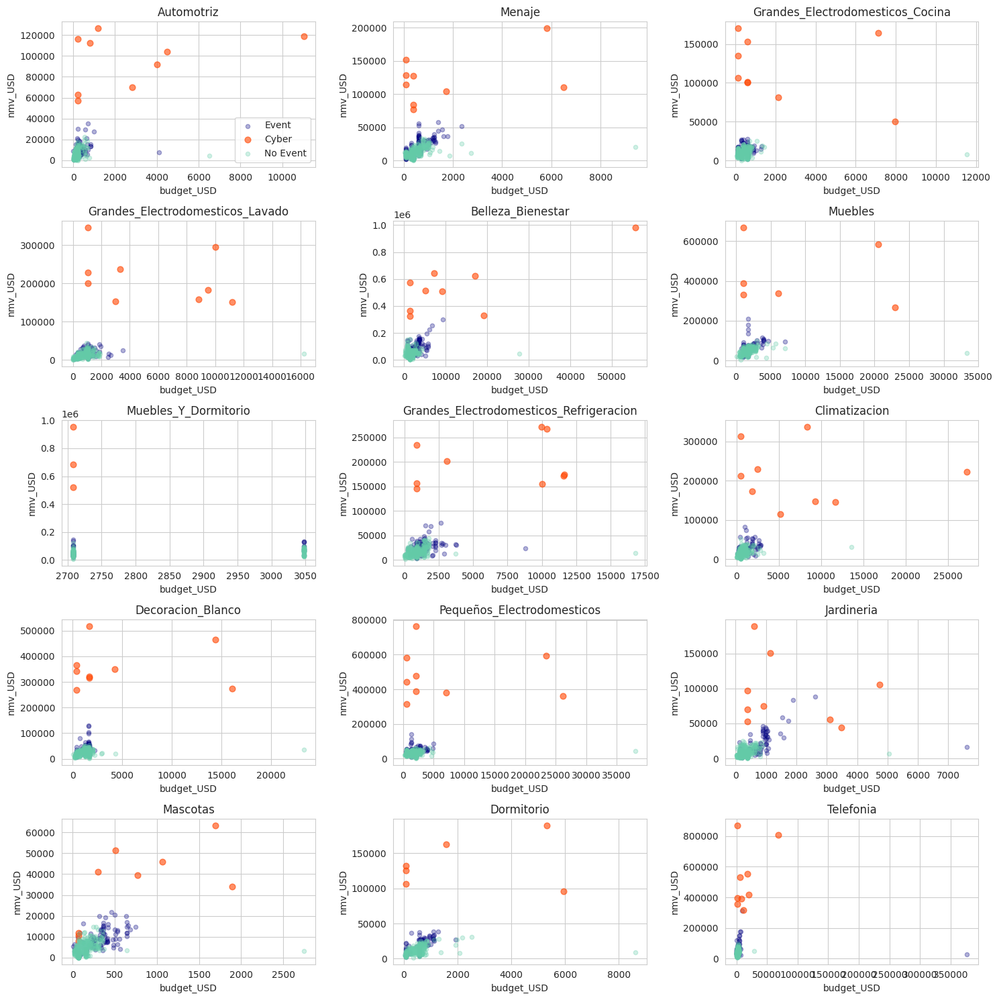

In [ ]:
x_ = 'budget_USD' #'cost_USD'
y_ = 'nmv_USD'

cols = 3
rows = 5
fig, axs = plt.subplots(rows, cols, figsize=(15,15))
fig.patch.set_facecolor('white')
for i, category in enumerate([*df_raw.campaign.unique()]):
    j = i%(rows)
    k = i%(cols)

    df = df_raw[(df_raw['campaign']==category)]
    df.reset_index(inplace=True)

    dfe=df[(df.is_event==1)&(df.is_cyber==0)]
    dfc=df[df.is_cyber==1]
    dfne=df[df.is_event==0]

    axs[j,k].set_title(category)
    if (j==0)&(k==0):
        axs[j,k].scatter(dfe[x_],dfe[y_], s=20, color='navy', alpha=0.3, label='Event')
        #axs[j,k].scatter(dfc[x_],dfc[y_], s=40, marker='^', color='green', alpha=0.6, label='Cyber') ## The form for cyber days is different
        axs[j,k].scatter(dfc[x_],dfc[y_], s=40,  color='orangered', alpha=0.6, label='Cyber')
        axs[j,k].scatter(dfne[x_],dfne[y_], s=20, color='mediumaquamarine', alpha=0.3, label='No Event')
        axs[j,k].legend()
    else:
        axs[j,k].scatter(dfe[x_],dfe[y_], s=20, color='navy', alpha=0.3)
        #axs[j,k].scatter(dfc[x_],dfc[y_], s=40, marker='^', color='green', alpha=0.6)  ## The form for cyber days is different
        axs[j,k].scatter(dfc[x_],dfc[y_], s=40, color='orangered', alpha=0.6)
        axs[j,k].scatter(dfne[x_],dfne[y_], s=20, color='mediumaquamarine', alpha=0.3)
    axs[j,k].set_xlabel(f'{x_}')
    axs[j,k].set_ylabel(f'{y_}')
    axs[j,k].grid(True)
plt.tight_layout()



---


##Este código me da error........no aparece bien la info.

In [ ]:
days_dict = {0: 'Monday',
             1: 'Tuestday',
             2: 'Wednesday',
             3: 'Thursday',
             4: 'Friday',
             5: 'Saturday',
             6: 'Sunday'}

fig, axs = plt.subplots(1, 1, figsize=(10, 5))
data = df_raw[(df_raw['campaign'] == 'Telefonia') & (df_raw['is_cyber'] == 0)]

for day in np.sort(data.week_day.unique()):
    u = data[data['week_day'] == day]['clicks']
    v = data[data['week_day'] == day]['impressions']
    axs.scatter(u, v, c=colors[int(day)], alpha=0.6, label= days_dict[day])

axs.set_ylabel('Impressions', fontsize=14)
axs.set_xlabel('Clicks', fontsize=14)
axs.tick_params(axis='both', labelsize=12)

axs.legend()
axs.grid()
plt.show()

7380     436.002508
7381     525.047023
7382     719.975631
7383     685.182118
7384    1545.916979
           ...     
7959    1479.178546
7960    1508.882921
7961    1807.976766
7962    1484.131641
7963    1618.496918
Name: cost_USD, Length: 582, dtype: float64


In [ ]:
corr = df_raw.corr()
corr.style.background_gradient(cmap='coolwarm')

,week_day,month_day,year_day,month_year,is_event,is_cyber,previous_cyber_days,clicks,impressions,visitors,visitors_pur,visits,orders,total_units_net,budget_USD,cost_USD,nmv_USD,is_week_day
week_day,1.000000,-0.008570,0.007445,0.008252,-0.014814,-0.124803,0.056338,-0.060626,-0.046954,-0.044521,-0.103600,-0.054241,-0.103270,-0.105020,-0.018886,-0.082858,-0.114387,-0.790448
month_day,-0.008570,1.000000,0.058639,-0.032010,-0.008441,0.034919,0.194629,-0.019489,-0.012310,-0.019622,-0.006381,-0.019527,-0.006644,-0.002958,0.024939,0.020553,0.001257,-0.000136
year_day,0.007445,0.058639,1.000000,0.995862,0.161953,0.040570,0.074556,0.074067,0.091728,0.100574,0.094966,0.100083,0.094245,0.104012,0.008172,0.055135,0.078214,-0.004424
month_year,0.008252,-0.032010,0.995862,1.000000,0.163075,0.037957,0.057481,0.076414,0.093150,0.102845,0.095929,0.102347,0.095234,0.104541,0.006001,0.053785,0.078500,-0.004421
is_event,-0.014814,-0.008441,0.161953,0.163075,1.000000,0.210804,0.122552,0.138814,0.146195,0.107384,0.209009,0.111598,0.209243,0.213922,0.064924,0.202836,0.229758,0.012668
is_cyber,-0.124803,0.034919,0.040570,0.037957,0.210804,1.000000,0.199775,0.254612,0.271958,0.198738,0.567413,0.229480,0.568960,0.575927,0.123978,0.631173,0.657649,0.079148
previous_cyber_days,0.056338,0.194629,0.074556,0.057481,0.122552,0.199775,1.000000,0.101145,0.120669,0.072866,0.090586,0.076692,0.090621,0.086402,0.076609,0.177245,0.098532,-0.031632
clicks,-0.060626,-0.019489,0.074067,0.076414,0.138814,0.254612,0.101145,1.000000,0.936045,0.922798,0.715161,0.906291,0.713482,0.680677,0.227751,0.660308,0.672832,0.025933
impressions,-0.046954,-0.012310,0.091728,0.093150,0.146195,0.271958,0.120669,0.936045,1.000000,0.940997,0.778734,0.934609,0.777152,0.753395,0.241048,0.683026,0.714344,0.013803
visitors,-0.044521,-0.019622,0.100574,0.102845,0.107384,0.198738,0.072866,0.922798,0.940997,1.000000,0.765817,0.996059,0.763590,0.722483,0.205883,0.555227,0.657315,0.019865


<Axes: title={'center': 'Variable correlations (No Outliers)'}>

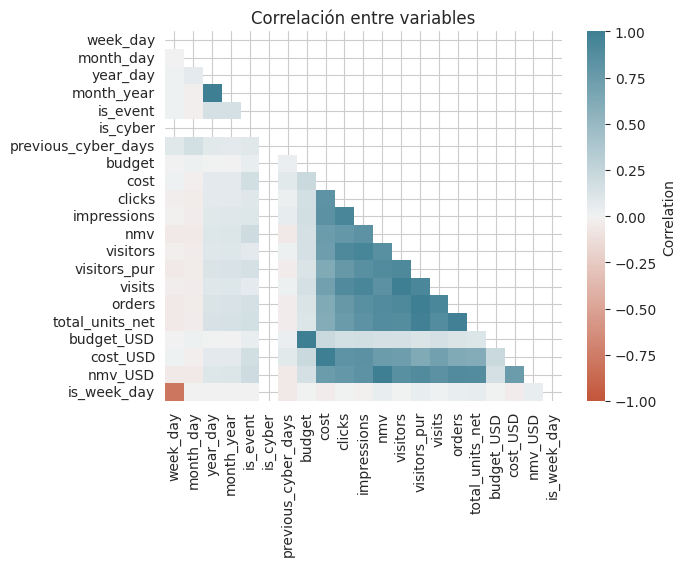

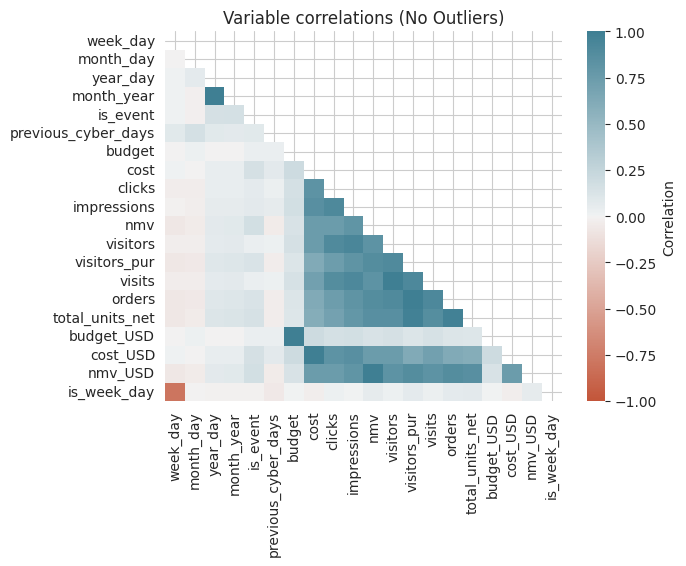

In [ ]:
df = df_raw[(df_raw.is_cyber==0)]
corrmat = df.corr()
mask= np.zeros_like(corrmat)
mask[np.triu_indices_from(mask)] = True
fig, ax = plt.subplots()  #plt.subplots(figsize=(15,15))
fig.patch.set_facecolor('white')
plt.title('Correlación entre variables')
sns.heatmap(corrmat,
            vmax=1, vmin=-1,
            annot=False, annot_kws={'fontsize':8},
            mask=mask,
            cmap=sns.diverging_palette(20,220,as_cmap=True),
            cbar_kws={'label': 'Correlation'},
            ax=ax)

df_ = df_nout
corrmat_nout = df_.corr()
mask= np.zeros_like(corrmat_nout)
mask[np.triu_indices_from(mask)] = True
fig, ax = plt.subplots()  #plt.subplots(figsize=(15,15))
fig.patch.set_facecolor('white')
plt.title('Variable correlations (No Outliers)')
sns.heatmap(corrmat_nout,
            vmax=1, vmin=-1,
            annot=False, annot_kws={'fontsize':8},
            mask=mask,
            cmap=sns.diverging_palette(20,220,as_cmap=True),
            cbar_kws={'label': 'Correlation'},
            ax=ax)

In [ ]:
df_raw.groupby('campaign')['date'].agg(['min', 'max'])

In [ ]:
df_raw[(df_raw['campaign']=='Menaje')].groupby('campaign')['visits'].agg('min')

campaign
Menaje    972
Name: visits, dtype: int64

In [ ]:
df_raw[(df_raw['campaign']=='Dormitorio')].groupby('campaign')['date'].agg(['min', 'max'])

,min,max
campaign,,
Dormitorio,2022-08-27,2023-08-22
